# Build a Conditional GAN

### Goals
In this notebook, you're going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). This will let you choose what digit you want to generate.

You'll then do some exploration of the generated images to visualize what the noise and class vectors mean.  

### Learning Objectives
1.   Learn the technical difference between a conditional and unconditional GAN.
2.   Understand the distinction between the class and noise vector in a conditional GAN.



## Getting Started

For this assignment, you will be using the MNIST dataset again, but there's nothing stopping you from applying this generator code to produce images of animals conditioned on the species or pictures of faces conditioned on facial characteristics.

Note that this assignment requires no changes to the architectures of the generator or discriminator, only changes to the data passed to both. The generator will no longer take `z_dim` as an argument, but  `input_dim` instead, since you need to pass in both the noise and class vectors. In addition to good variable naming, this also means that you can use the generator and discriminator code you have previously written with different parameters.

You will begin by importing the necessary libraries and building the generator and discriminator.

#### Packages and Visualization

In [2]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [3]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [4]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels in the images, fitted for the dataset used, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. There is a class within the PyTorch functional library that can help you.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">get_one_hot_labels</font></code></b>
</font>
</summary>

1.   This code can be done in one line.
2.   The documentation for [F.one_hot](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.one_hot) may be helpful.

</details>


In [5]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_one_hot_labels

import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    #### START CODE HERE ####
    return F.one_hot(labels, n_classes)
    #### END CODE HERE ####

In [6]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
print("Success!")

Success!


Next, you need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. You will also need to do this when adding the class channels to the discriminator.

To do this, you will need to write a function that combines two vectors. Remember that you need to ensure that the vectors are the same type: floats. Again, you can look to the PyTorch library for help.
<details>
<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">combine_vectors</font></code></b>
</font>
</summary>

1.   This code can also be written in one line.
2.   The documentation for [torch.cat](https://pytorch.org/docs/master/generated/torch.cat.html) may be helpful.
3.   Specifically, you might want to look at what the `dim` argument of `torch.cat` does.

</details>


In [19]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: combine_vectors
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    #### START CODE HERE ####
    combined = torch.cat([x.type(torch.float), y.type(torch.float)], 1)
    #### END CODE HERE ####
    return combined

In [20]:
combined = combine_vectors(torch.tensor([[1, 2], [3, 4]]), torch.tensor([[5, 6], [7, 8]]));
# Check exact order of elements
assert torch.all(combined == torch.tensor([[1, 2, 5, 6], [3, 4, 7, 8]]))
# Tests that items are of float type
assert (type(combined[0][0].item()) == float)
# Check shapes
combined = combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5));
assert tuple(combined.shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
print("Success!")

Success!


## Training
Now you can start to put it all together!
First, you will define some new parameters:

*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [13]:
mnist_shape = (1, 28, 28)
n_classes = 10

And you also include the same parameters from previous assignments:

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [14]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, discriminator, and optimizers. To do this, you will need to update the input dimensions for both models. For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [15]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_input_dimensions
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    #### START CODE HERE ####
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes
    #### END CODE HERE ####
    return generator_input_dim, discriminator_im_chan

In [16]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [17]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, you would like both your generator and your discriminator to know what class of image should be generated. There are a few locations where you will need to implement code.

For example, if you're generating a picture of the number "1", you would need to:
  
1.   Tell that to the generator, so that it knows it should be generating a "1"
2.   Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

There are no explicit unit tests here -- if this block of code runs and you don't change any of the other variables, then you've done it correctly!

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Step 500: Generator loss: 2.183285823225975, discriminator loss: 0.2655862327888608


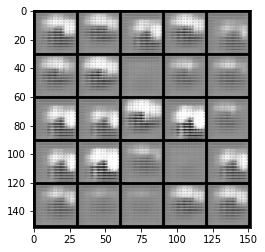

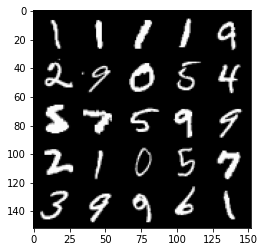

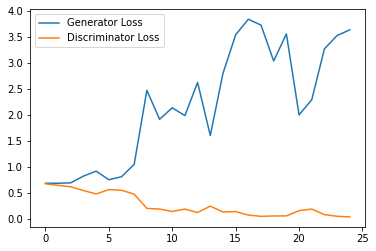

Step 1000: Generator loss: 4.439804938793182, discriminator loss: 0.03148535201139748


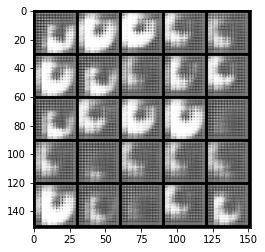

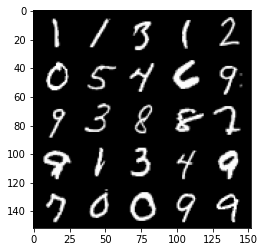

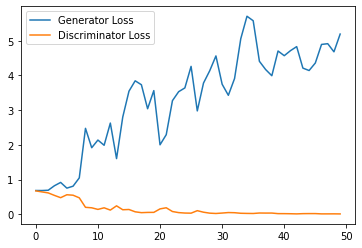

Step 1500: Generator loss: 4.9818523416519165, discriminator loss: 0.03053306456375867


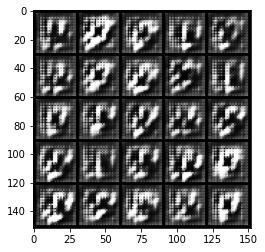

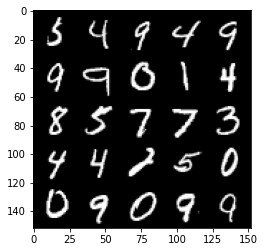

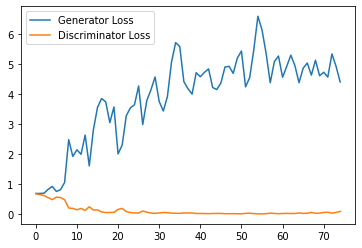

Step 2000: Generator loss: 4.06323162984848, discriminator loss: 0.0764680173508823


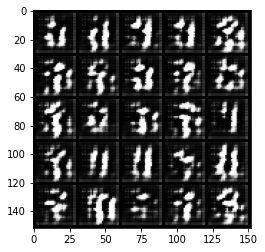

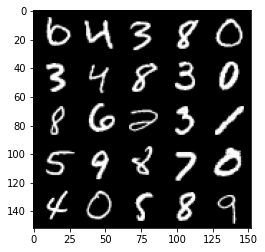

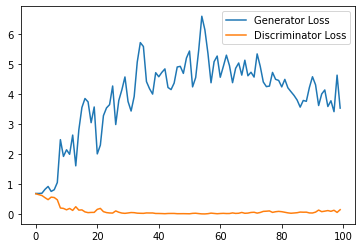

Step 2500: Generator loss: 3.3060475702285768, discriminator loss: 0.14884597777575254


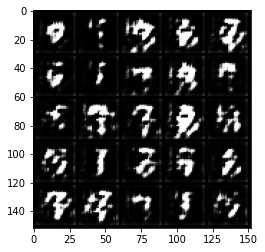

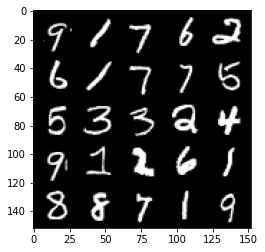

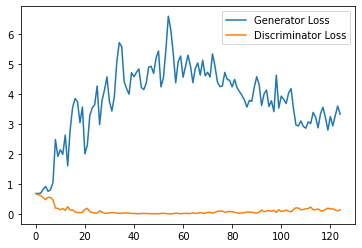

Step 3000: Generator loss: 2.7386954970359803, discriminator loss: 0.203594706133008


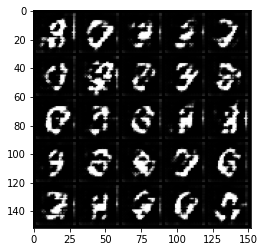

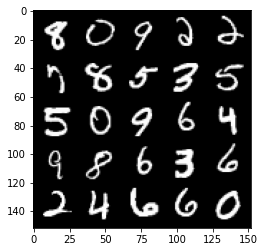

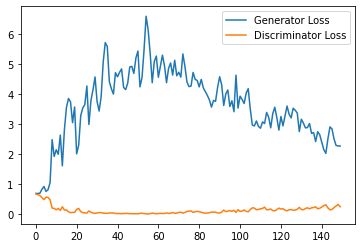

Step 3500: Generator loss: 2.578849314689636, discriminator loss: 0.22909241157770158


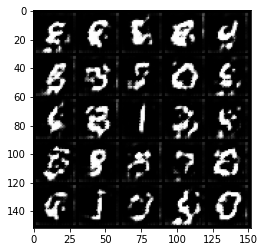

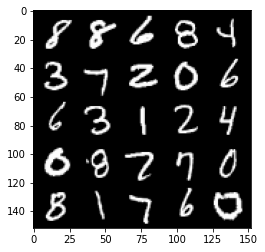

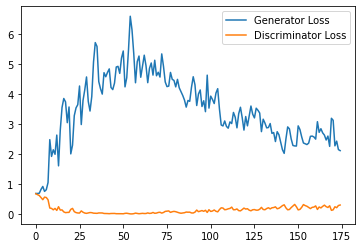

Step 4000: Generator loss: 2.3133161900043486, discriminator loss: 0.26192571145296095


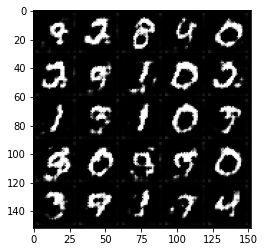

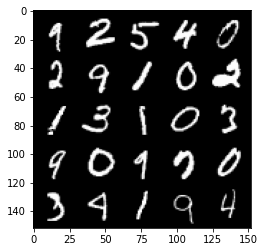

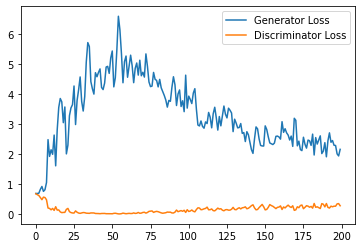

Step 4500: Generator loss: 2.3545022225379943, discriminator loss: 0.28596510645747186


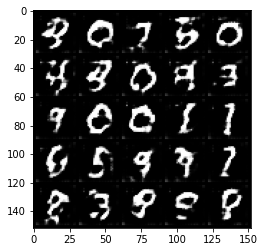

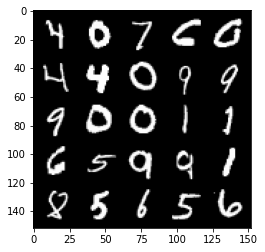

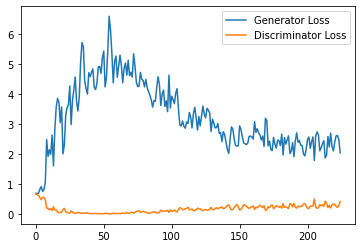

Step 5000: Generator loss: 2.0632461738586425, discriminator loss: 0.3063017345368862


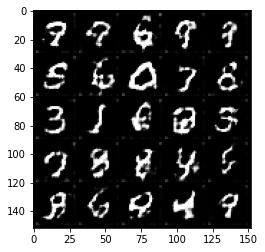

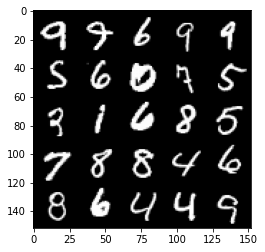

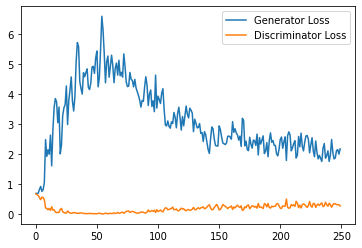

Step 5500: Generator loss: 1.9530091469287871, discriminator loss: 0.34806258043646815


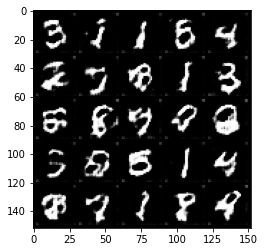

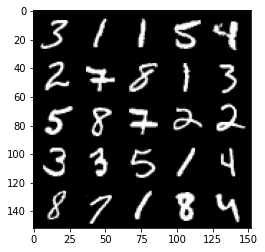

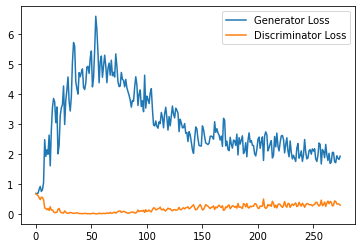

Step 6000: Generator loss: 1.8596838080883027, discriminator loss: 0.3781387070417404


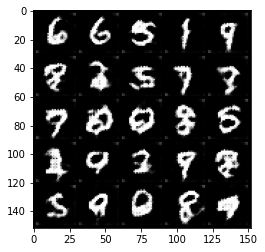

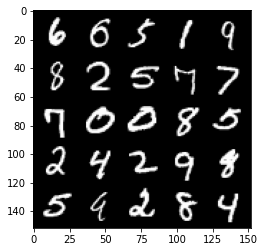

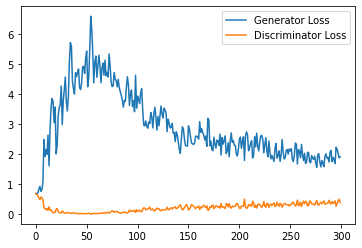

Step 6500: Generator loss: 1.698707153081894, discriminator loss: 0.3902352976500988


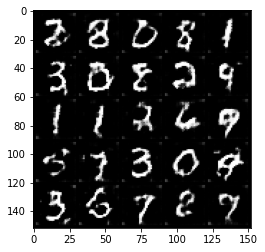

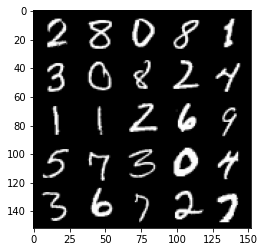

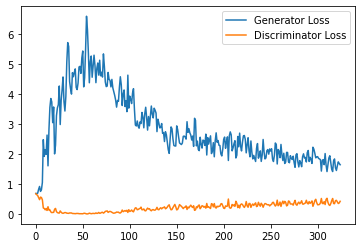

Step 7000: Generator loss: 1.6897183680534362, discriminator loss: 0.41225222805142403


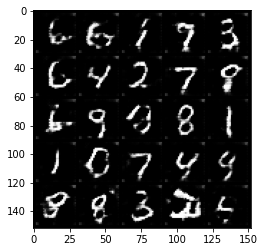

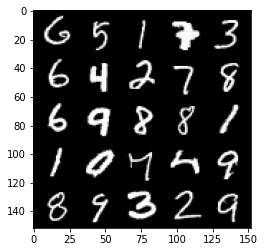

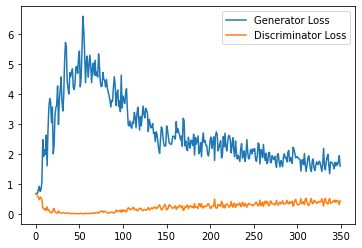

Step 7500: Generator loss: 1.6527486116886139, discriminator loss: 0.4435274544656277


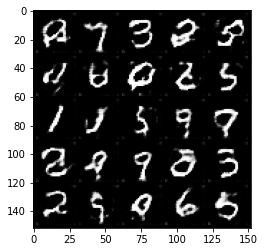

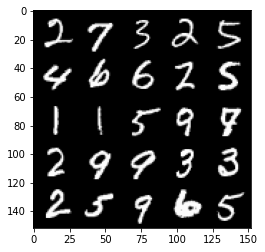

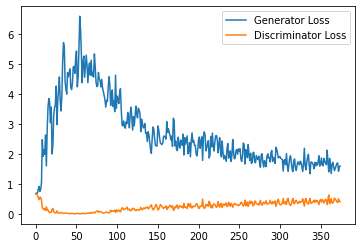

Step 8000: Generator loss: 1.4606348736286163, discriminator loss: 0.45644069945812227


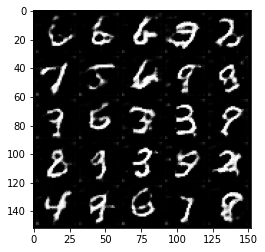

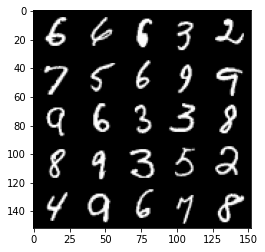

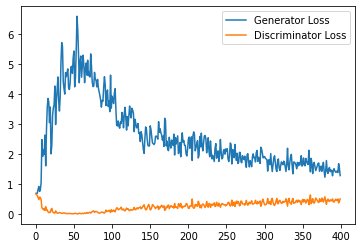

Step 8500: Generator loss: 1.5812277987003327, discriminator loss: 0.4657942609190941


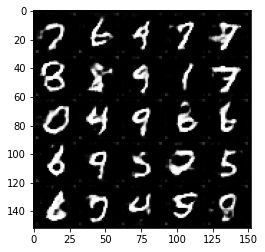

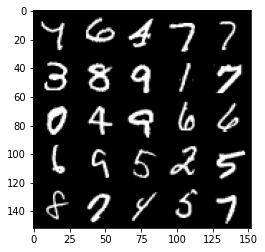

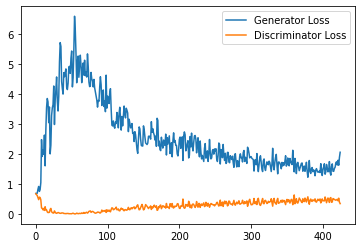

Step 9000: Generator loss: 1.4703282806873321, discriminator loss: 0.4866990807056427


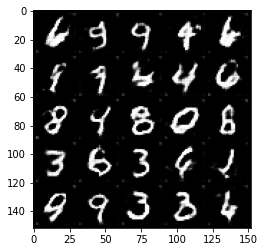

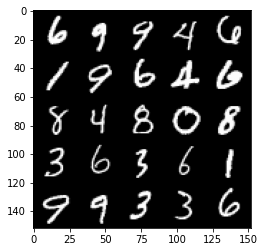

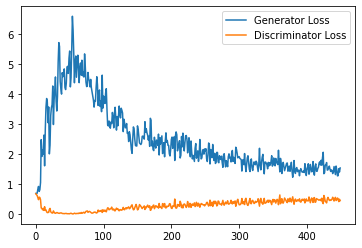

Step 9500: Generator loss: 1.4169134896993638, discriminator loss: 0.48877616399526597


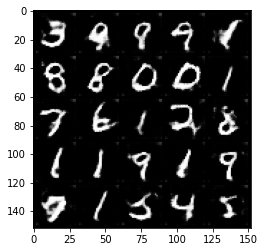

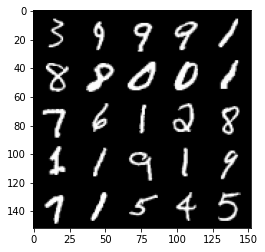

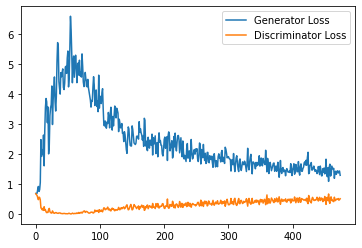

Step 10000: Generator loss: 1.413482654452324, discriminator loss: 0.4766156498193741


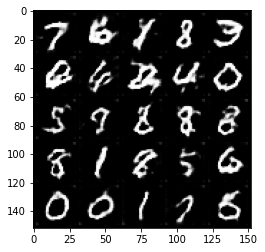

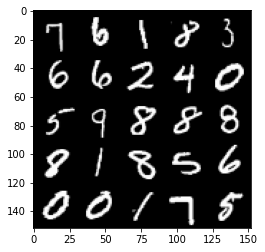

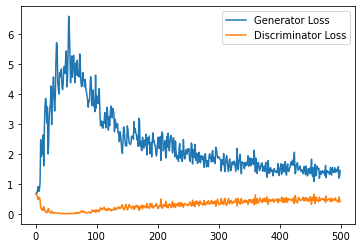

Step 10500: Generator loss: 1.3636454961299895, discriminator loss: 0.4899491943717003


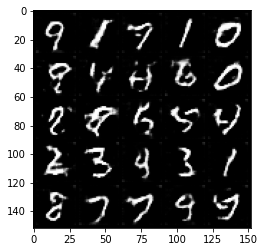

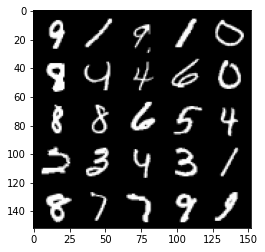

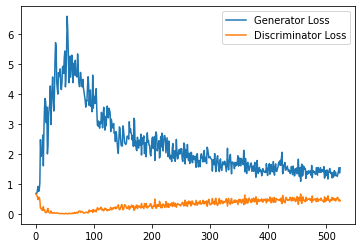

Step 11000: Generator loss: 1.3953154193162918, discriminator loss: 0.4935361360907555


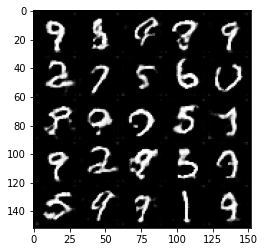

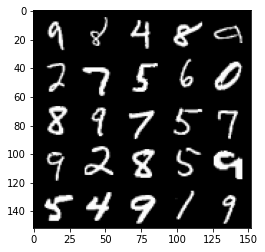

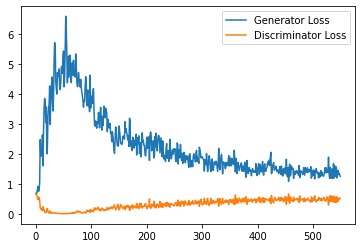

Step 11500: Generator loss: 1.4024652326107026, discriminator loss: 0.4949980792999268


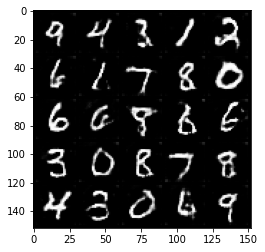

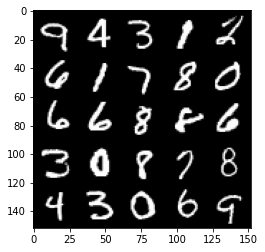

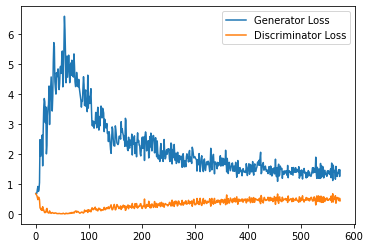

Step 12000: Generator loss: 1.3375304684638978, discriminator loss: 0.5103348082900048


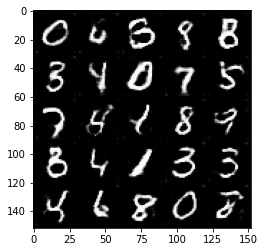

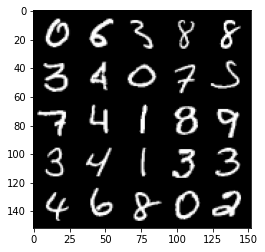

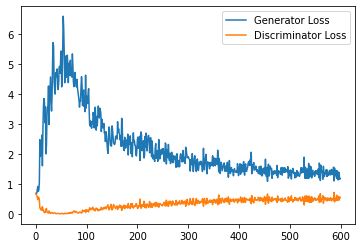

Step 12500: Generator loss: 1.2081394735574722, discriminator loss: 0.5208423443436623


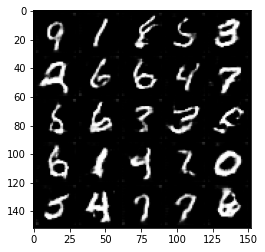

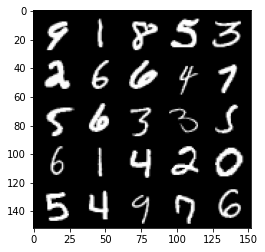

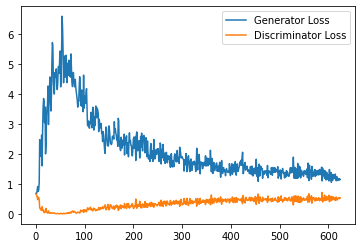

Step 13000: Generator loss: 1.323300808787346, discriminator loss: 0.5183947941064835


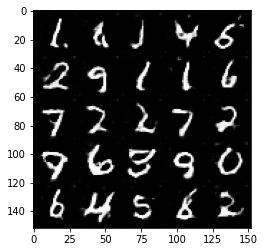

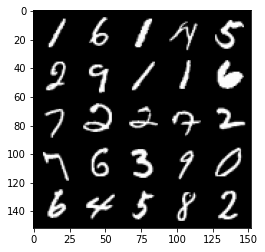

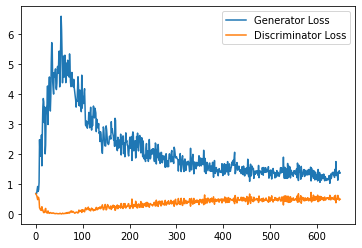

Step 13500: Generator loss: 1.17711723613739, discriminator loss: 0.5542229277491569


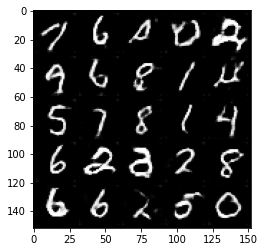

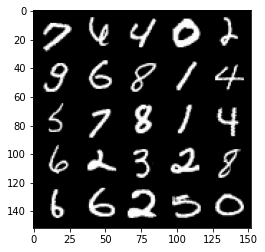

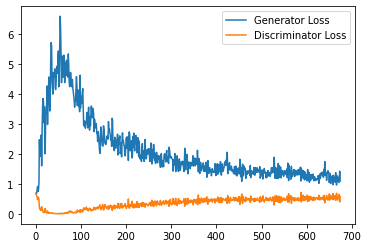

Step 14000: Generator loss: 1.1904558132886887, discriminator loss: 0.5513602742552757


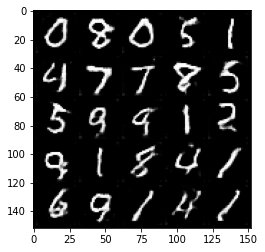

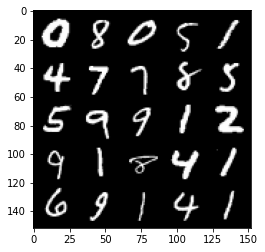

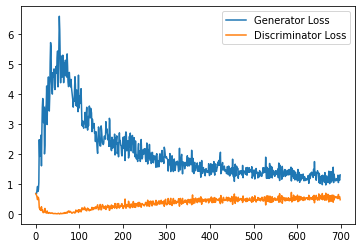

Step 14500: Generator loss: 1.2209458268880844, discriminator loss: 0.55049202054739


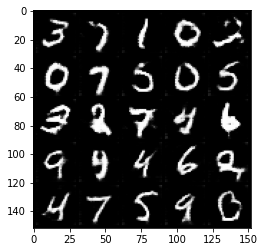

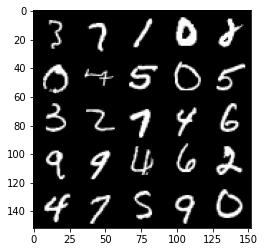

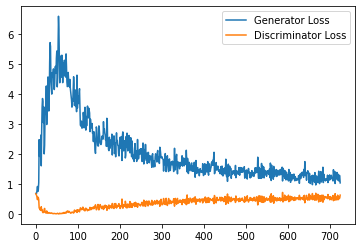

Step 15000: Generator loss: 1.1629102602005006, discriminator loss: 0.5401893031597137


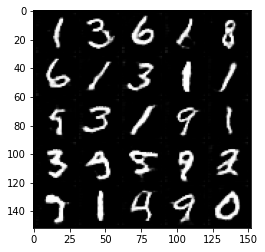

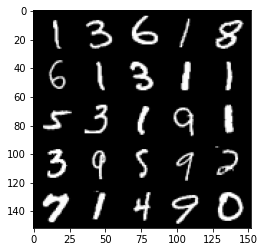

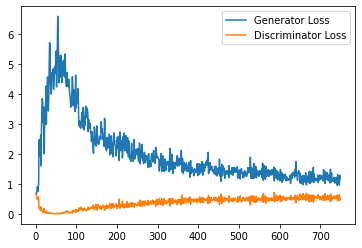

Step 15500: Generator loss: 1.1719699512720108, discriminator loss: 0.5646598777174949


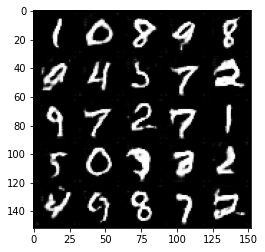

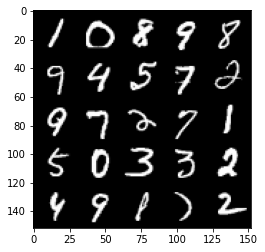

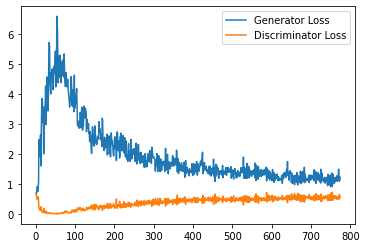

Step 16000: Generator loss: 1.2137182819843293, discriminator loss: 0.5574056341648101


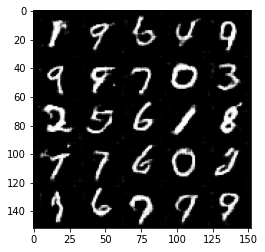

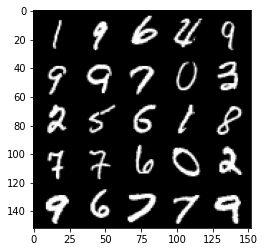

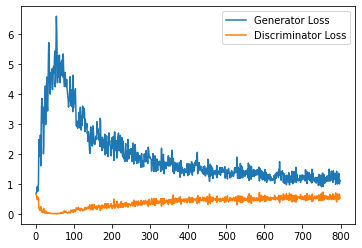

Step 16500: Generator loss: 1.1181512854099274, discriminator loss: 0.5572799543142318


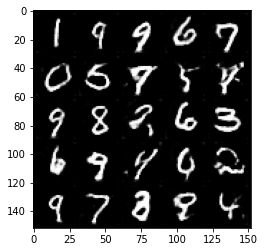

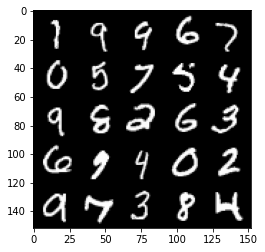

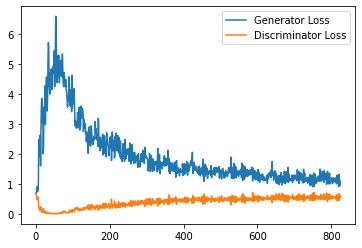

Step 17000: Generator loss: 1.089595698595047, discriminator loss: 0.5656391733288765


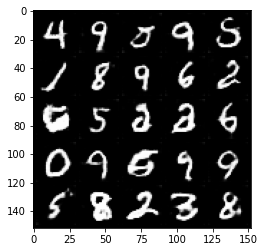

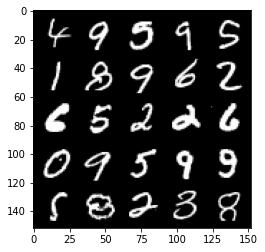

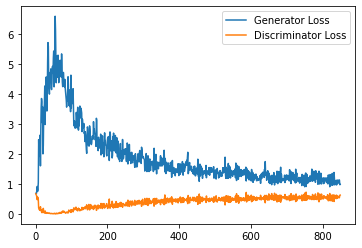

Step 17500: Generator loss: 1.1290589773654938, discriminator loss: 0.5628310890197754


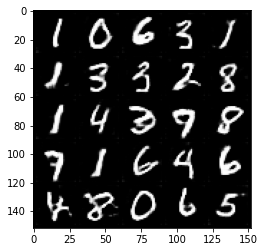

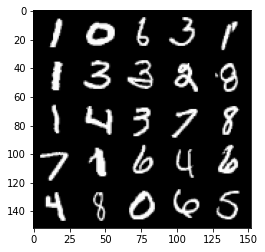

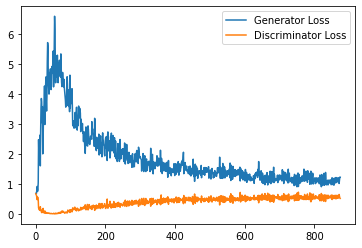

Step 18000: Generator loss: 1.150147817850113, discriminator loss: 0.5677886999845505


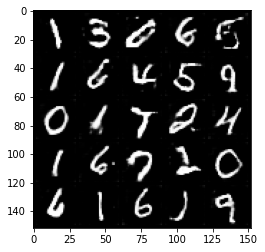

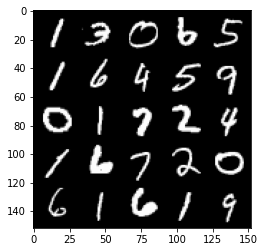

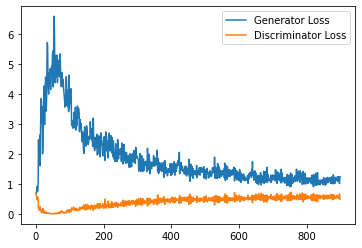

Step 18500: Generator loss: 1.1416584876775742, discriminator loss: 0.5647232484221458


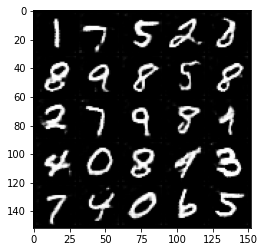

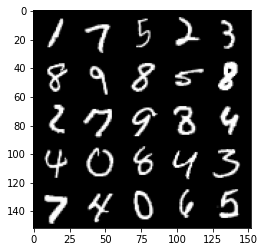

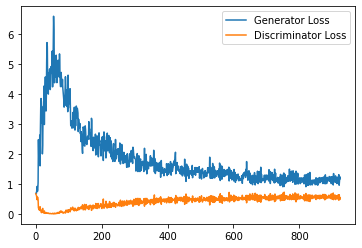

Step 19000: Generator loss: 1.096300647854805, discriminator loss: 0.5727028114795685


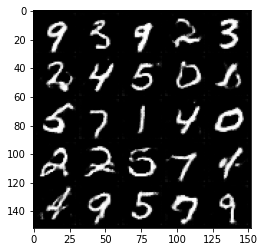

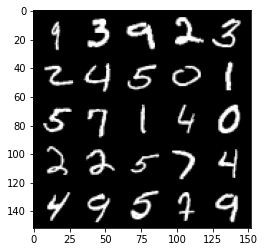

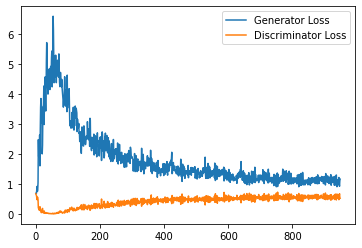

Step 19500: Generator loss: 1.127692636370659, discriminator loss: 0.5684809972643852


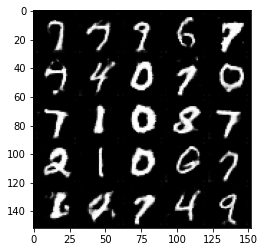

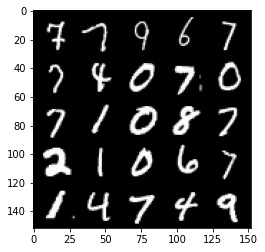

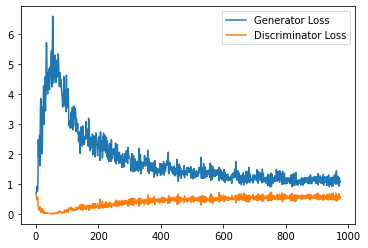

Step 20000: Generator loss: 1.127084502696991, discriminator loss: 0.5732789423465728


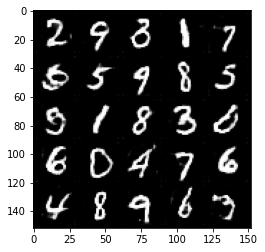

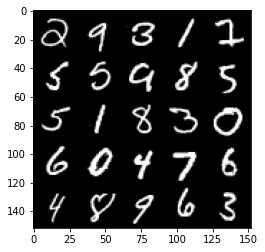

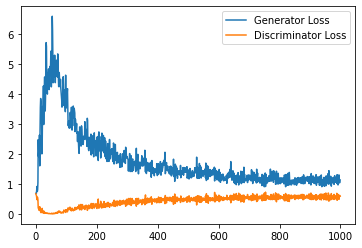

Step 20500: Generator loss: 1.1104166254997254, discriminator loss: 0.5749653343558312


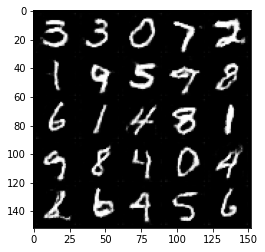

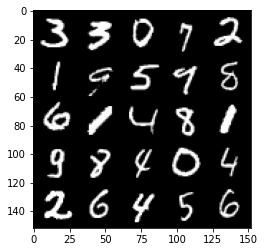

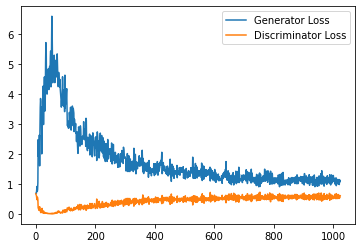

Step 21000: Generator loss: 1.093544640660286, discriminator loss: 0.572843928694725


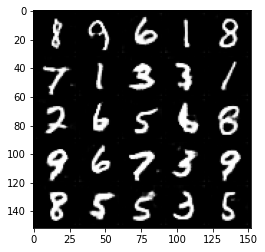

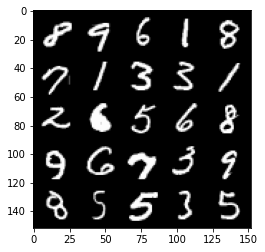

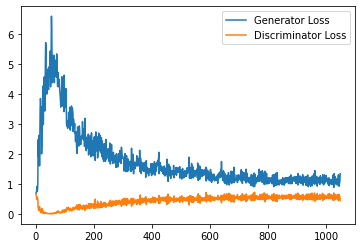

Step 21500: Generator loss: 1.0536560962200165, discriminator loss: 0.5807981107234955


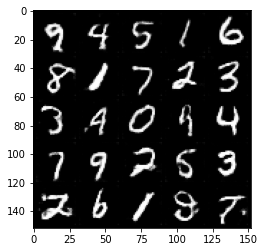

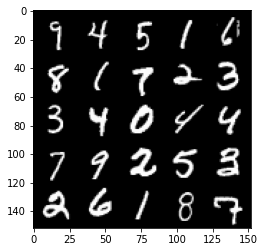

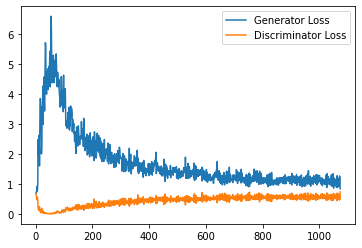

Step 22000: Generator loss: 1.1003536850214004, discriminator loss: 0.5706406747102737


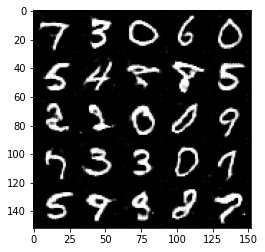

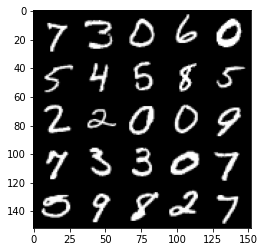

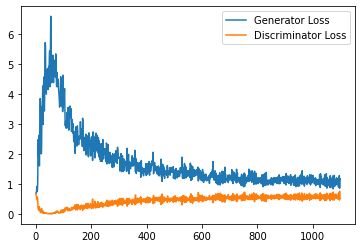

Step 22500: Generator loss: 1.0745670289993285, discriminator loss: 0.5712021380662918


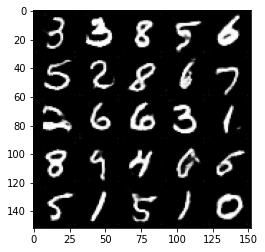

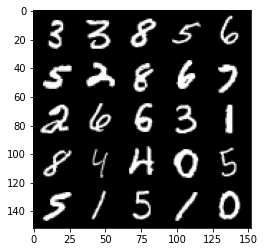

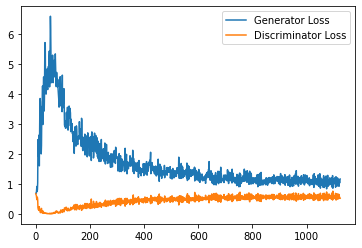

Step 23000: Generator loss: 1.0905143245458604, discriminator loss: 0.5804190840721131


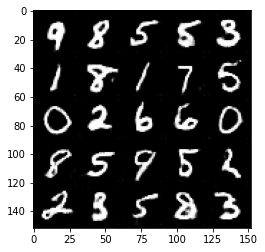

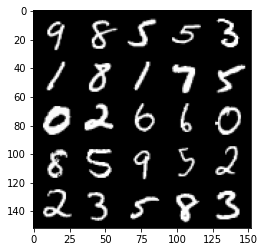

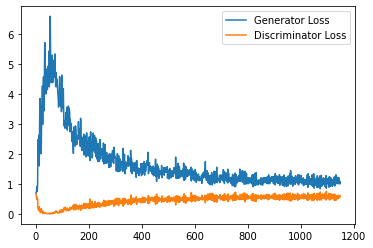

Step 23500: Generator loss: 1.0665257563591004, discriminator loss: 0.5745070577859879


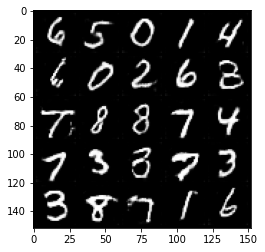

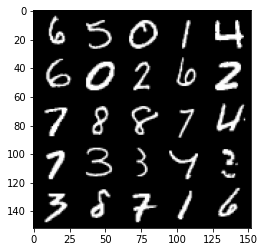

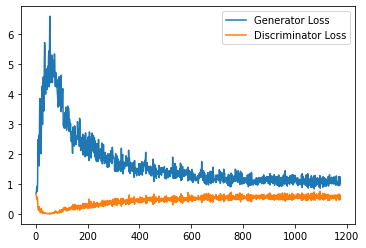

Step 24000: Generator loss: 1.060067347764969, discriminator loss: 0.5888836201429367


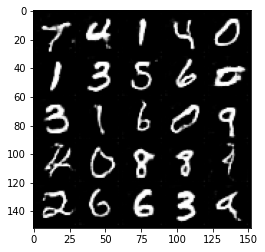

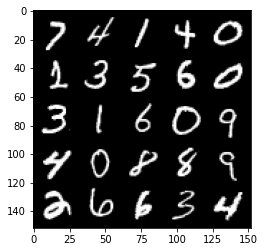

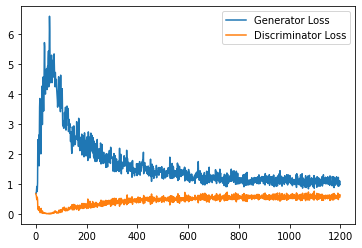

Step 24500: Generator loss: 1.0733535922765731, discriminator loss: 0.5819981202483178


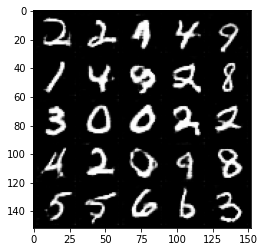

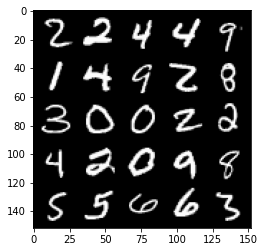

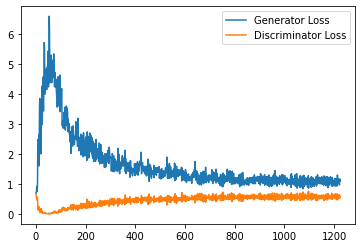

Step 25000: Generator loss: 1.0801848405599594, discriminator loss: 0.5863735934495926


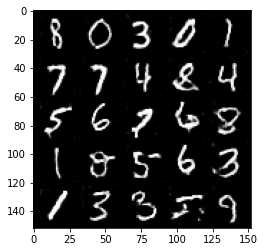

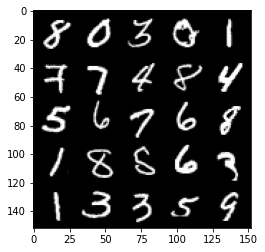

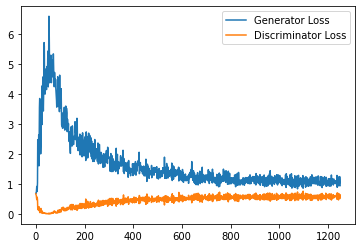

Step 25500: Generator loss: 1.0365600661039351, discriminator loss: 0.5852250115871429


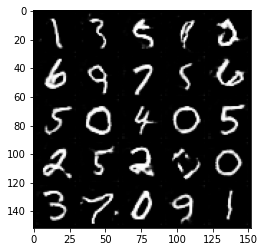

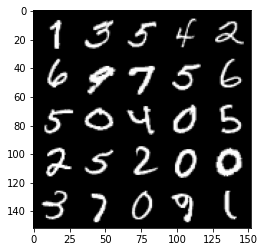

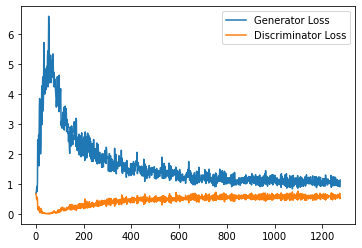

Step 26000: Generator loss: 1.0495242197513581, discriminator loss: 0.5808591876029968


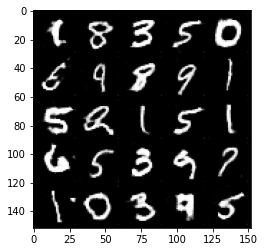

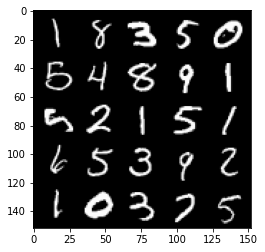

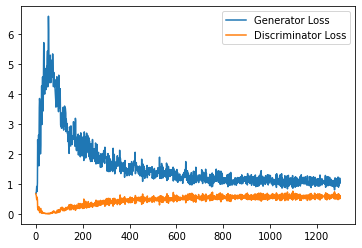

Step 26500: Generator loss: 1.067534155011177, discriminator loss: 0.5858419119715691


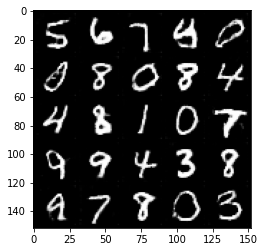

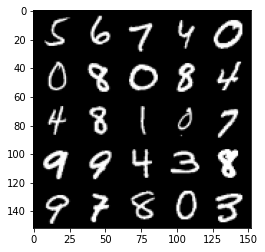

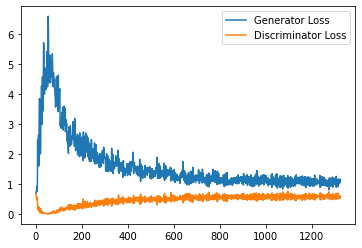

Step 27000: Generator loss: 1.093775313615799, discriminator loss: 0.5872116786837578


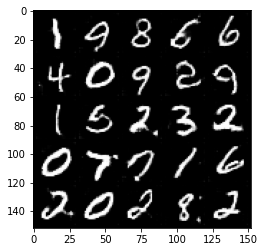

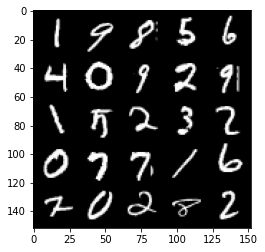

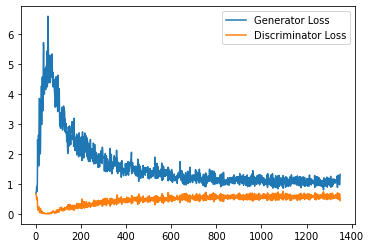

Step 27500: Generator loss: 1.0679905639886855, discriminator loss: 0.5886961658596992


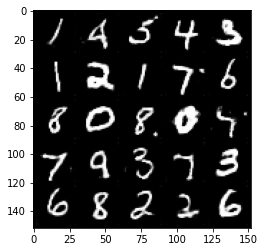

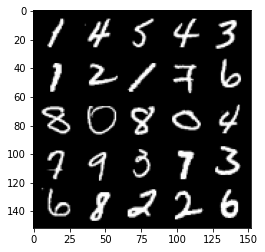

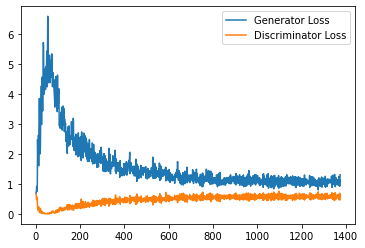

Step 28000: Generator loss: 1.022576267004013, discriminator loss: 0.5916524594426155


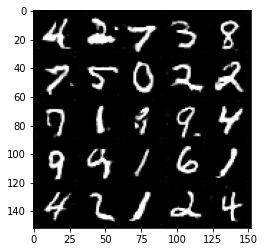

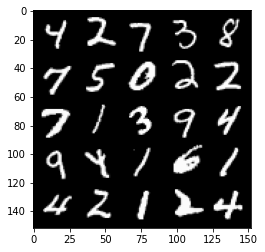

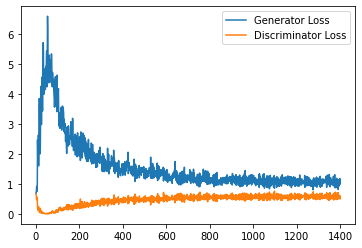

Step 28500: Generator loss: 1.0442187303304673, discriminator loss: 0.5884980808496475


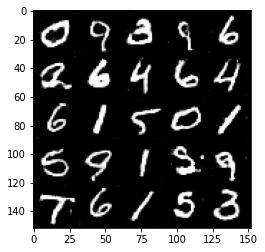

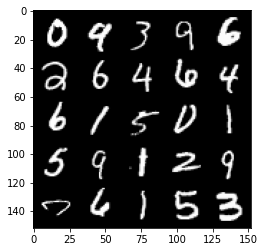

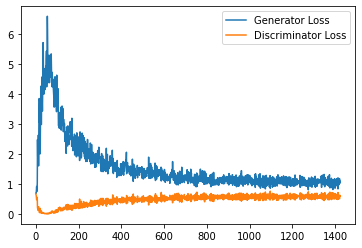

Step 29000: Generator loss: 1.0670824357271194, discriminator loss: 0.5950506063699722


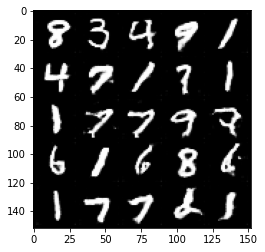

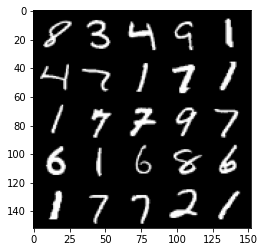

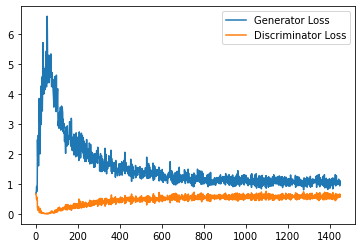

Step 29500: Generator loss: 1.0945343557596208, discriminator loss: 0.588175262272358


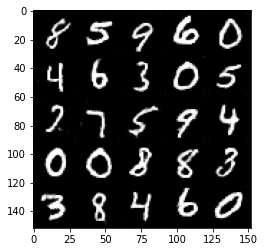

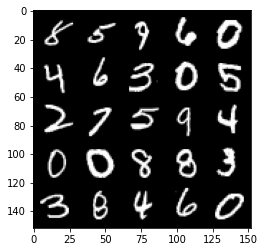

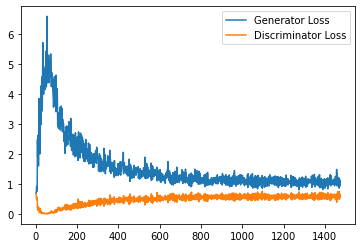

Step 30000: Generator loss: 1.036217946410179, discriminator loss: 0.5971596459150315


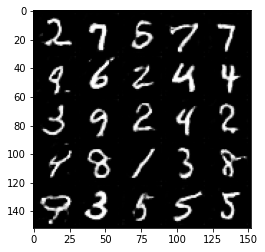

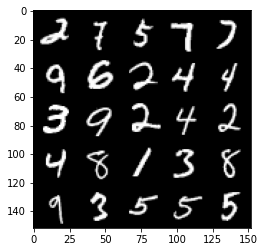

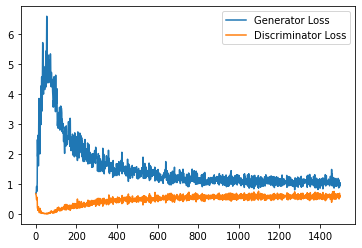

Step 30500: Generator loss: 1.0147662283182144, discriminator loss: 0.5978223000764846


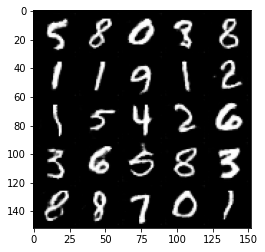

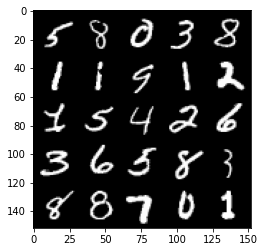

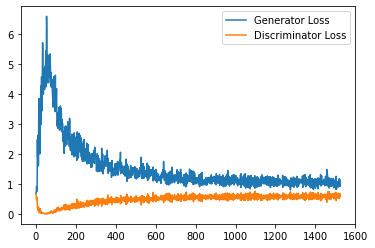

Step 31000: Generator loss: 1.0498645300865173, discriminator loss: 0.5888436659574509


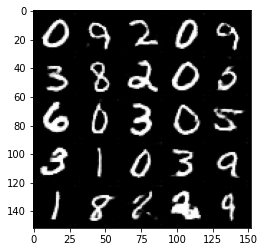

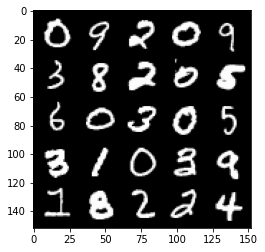

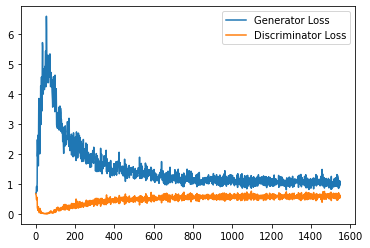

Step 31500: Generator loss: 1.0293554465770722, discriminator loss: 0.5953438212871551


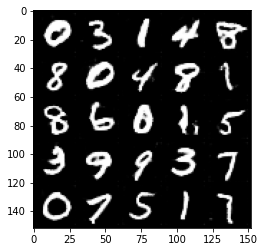

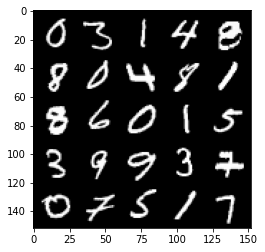

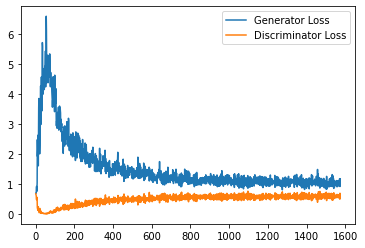

Step 32000: Generator loss: 1.004307093501091, discriminator loss: 0.5973294801712036


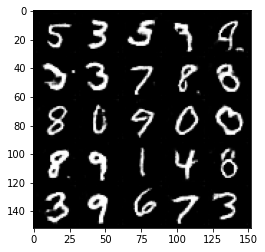

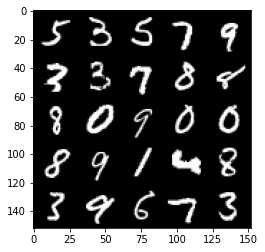

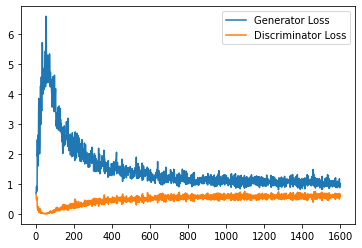

Step 32500: Generator loss: 1.0235844702720642, discriminator loss: 0.5947420091032982


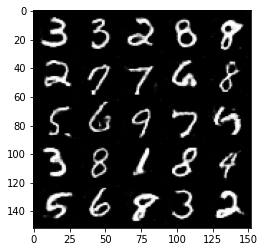

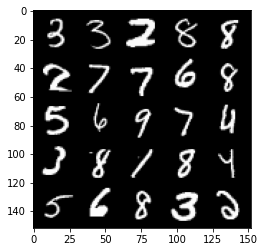

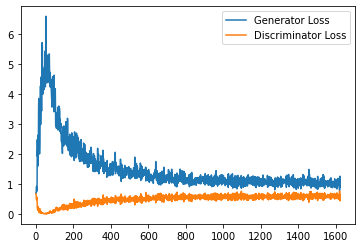

Step 33000: Generator loss: 1.0000552077293396, discriminator loss: 0.599700301527977


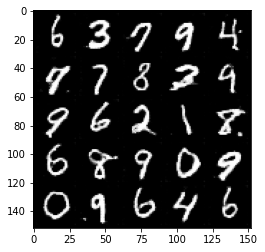

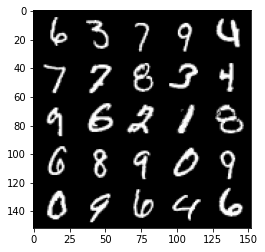

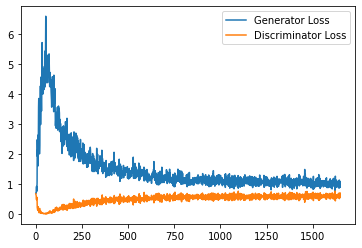

Step 33500: Generator loss: 1.0429256455898286, discriminator loss: 0.5860751426815987


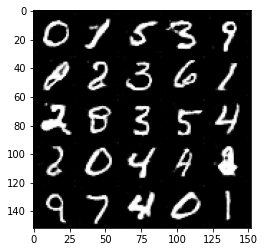

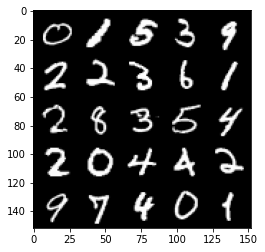

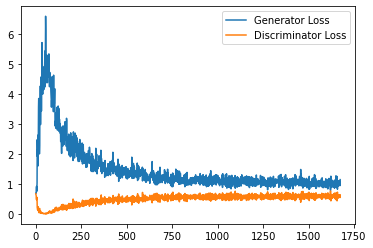

Step 34000: Generator loss: 1.0656647555828094, discriminator loss: 0.5912882059216499


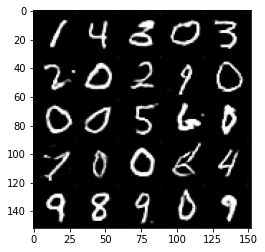

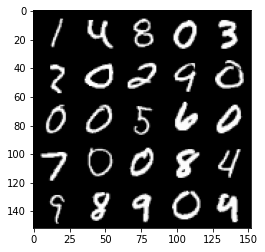

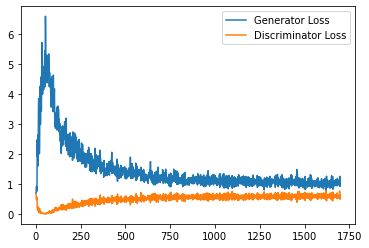

Step 34500: Generator loss: 1.0185000528097152, discriminator loss: 0.5954709538221359


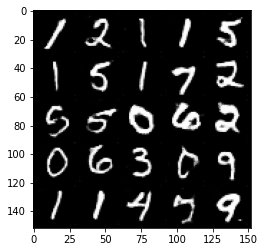

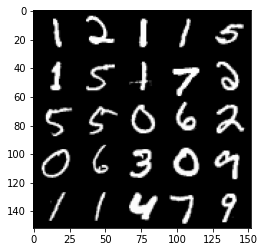

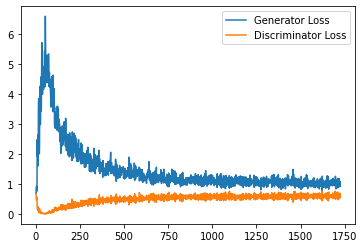

Step 35000: Generator loss: 1.0238232790231705, discriminator loss: 0.5882238743305206


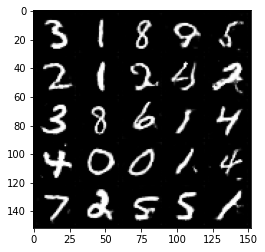

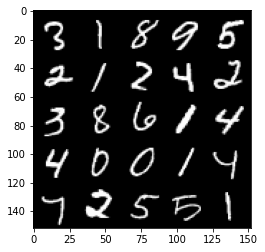

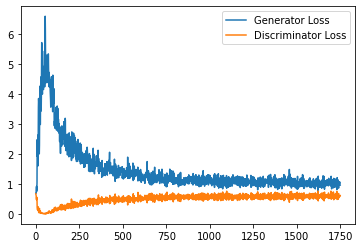

Step 35500: Generator loss: 1.0524998449087144, discriminator loss: 0.5919392554759979


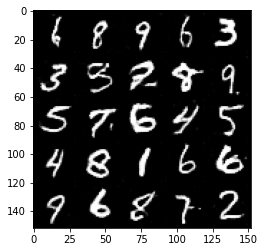

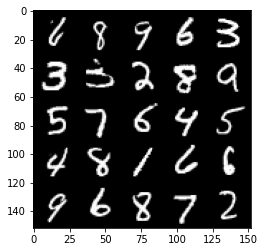

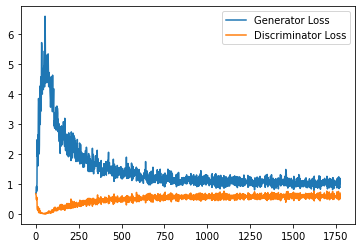

Step 36000: Generator loss: 1.006478307723999, discriminator loss: 0.5960570737719536


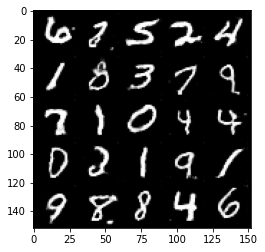

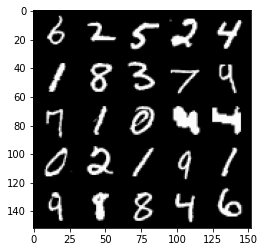

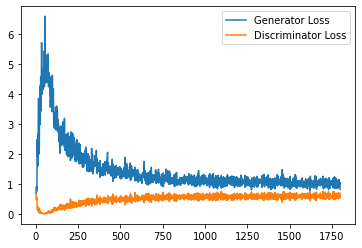

Step 36500: Generator loss: 1.0083568575382234, discriminator loss: 0.5851423282027245


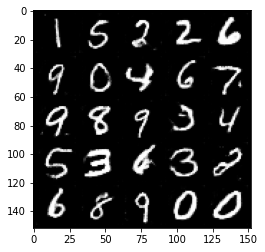

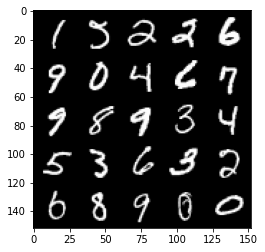

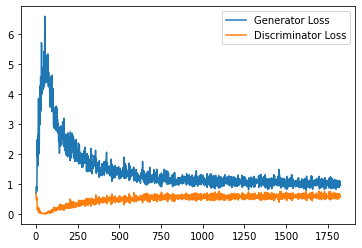

Step 37000: Generator loss: 1.020185288310051, discriminator loss: 0.583761865079403


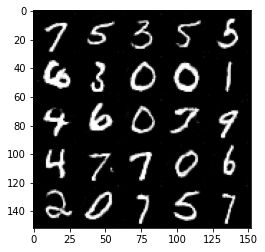

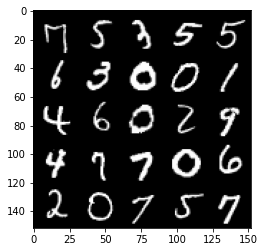

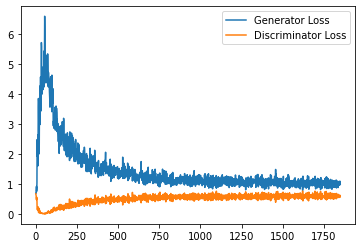

Step 37500: Generator loss: 1.0475533695220947, discriminator loss: 0.5898495371341705


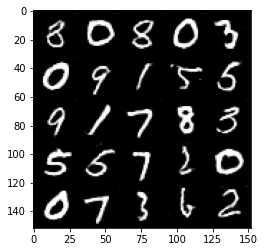

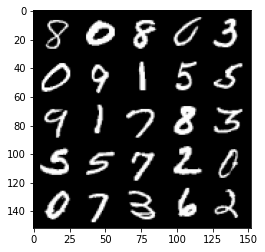

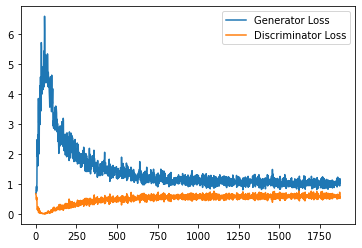

Step 38000: Generator loss: 1.0511440502405167, discriminator loss: 0.584572782933712


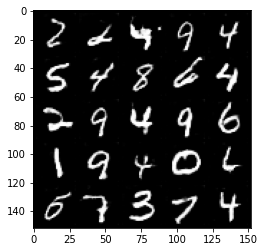

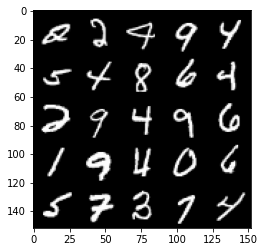

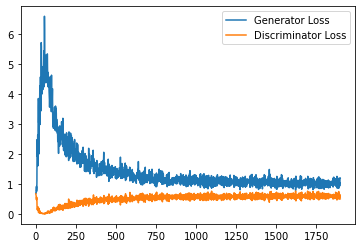

Step 38500: Generator loss: 1.0161895341873168, discriminator loss: 0.5891076126098633


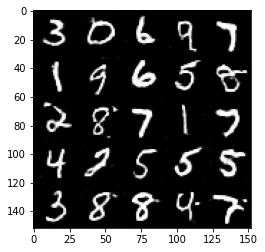

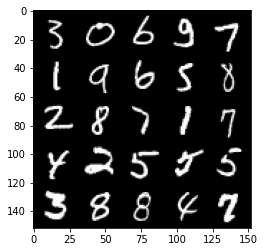

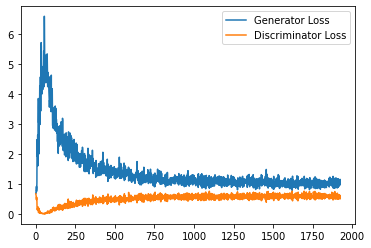

Step 39000: Generator loss: 1.0122226959466933, discriminator loss: 0.5885741281509399


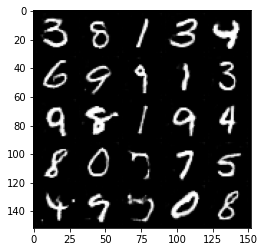

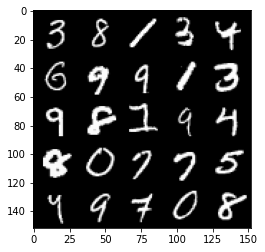

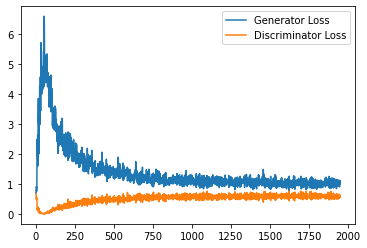

Step 39500: Generator loss: 1.0249880900382995, discriminator loss: 0.5828728671073914


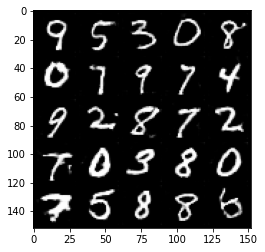

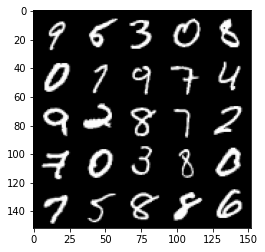

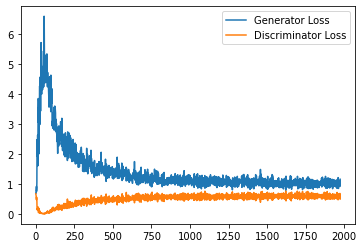

Step 40000: Generator loss: 1.0236869035959244, discriminator loss: 0.5852728660702705


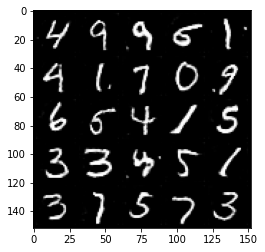

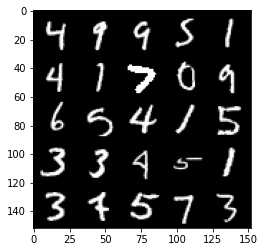

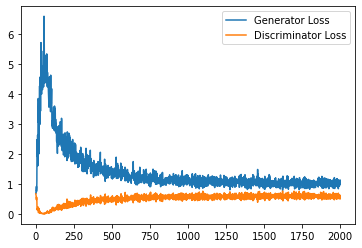

Step 40500: Generator loss: 1.0403579936027527, discriminator loss: 0.5852500675916672


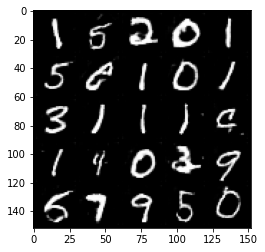

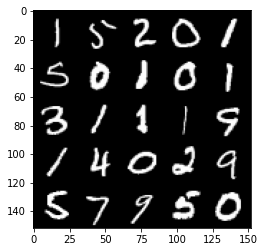

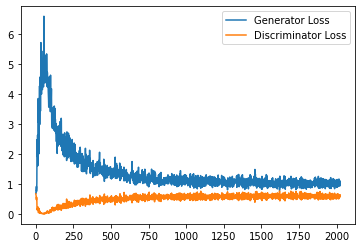

Step 41000: Generator loss: 1.043531280517578, discriminator loss: 0.5839979369044304


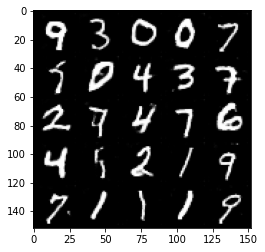

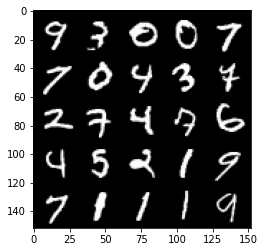

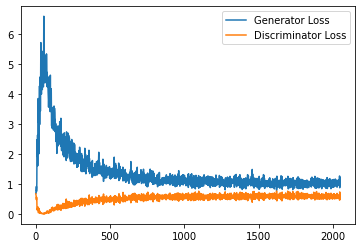

Step 41500: Generator loss: 1.0401670439243316, discriminator loss: 0.5826133189797401


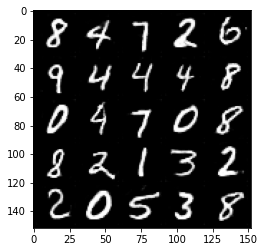

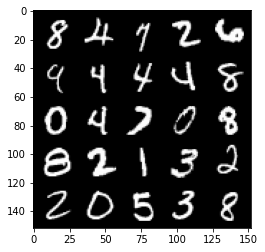

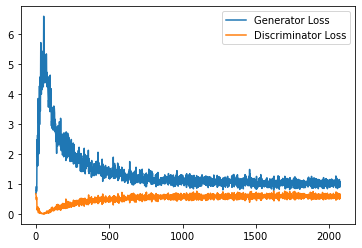

Step 42000: Generator loss: 1.0332170268297196, discriminator loss: 0.5834372255206108


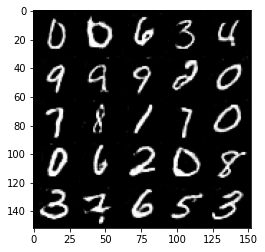

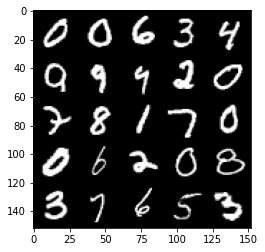

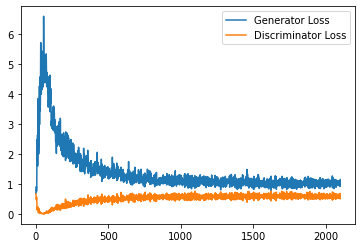

Step 42500: Generator loss: 1.0378025416135788, discriminator loss: 0.5754575031399727


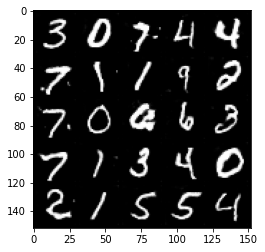

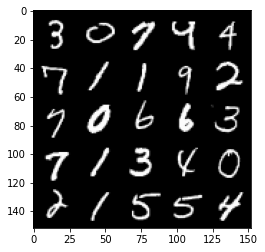

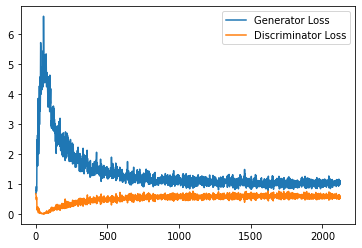

Step 43000: Generator loss: 1.038672839999199, discriminator loss: 0.5811234059333801


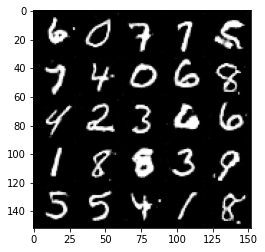

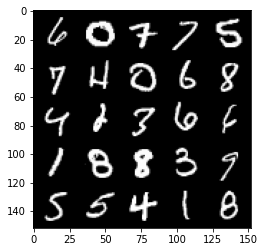

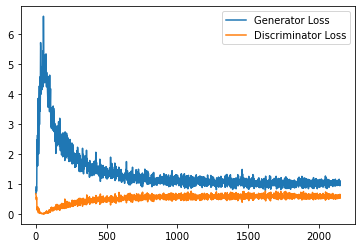

Step 43500: Generator loss: 1.0645574412345886, discriminator loss: 0.579070564687252


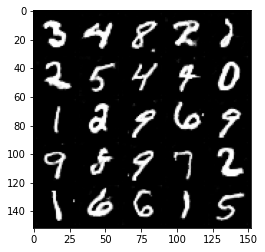

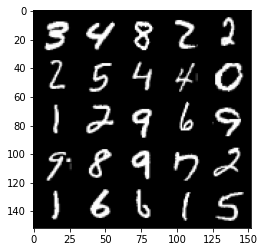

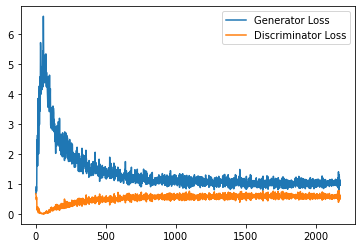

Step 44000: Generator loss: 1.0283808759450912, discriminator loss: 0.5782367973327637


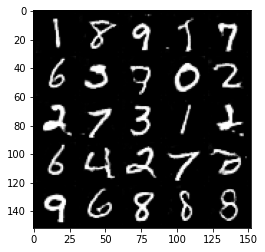

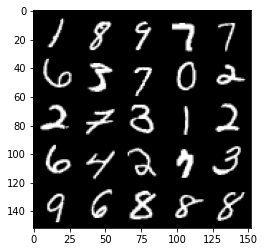

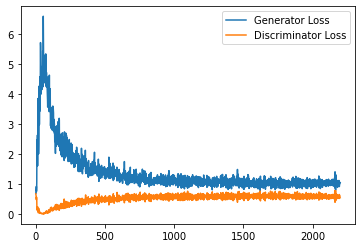

Step 44500: Generator loss: 1.0295453122854232, discriminator loss: 0.5774040879607201


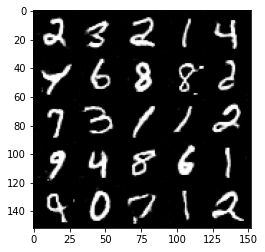

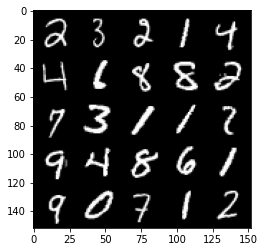

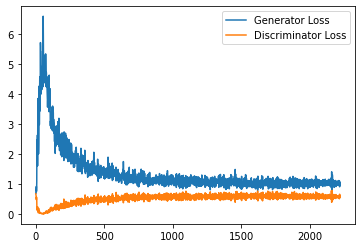

Step 45000: Generator loss: 1.057602889418602, discriminator loss: 0.5806778815984726


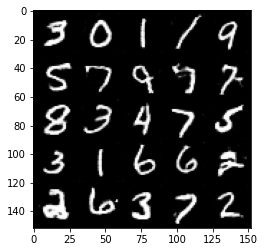

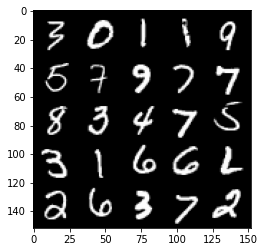

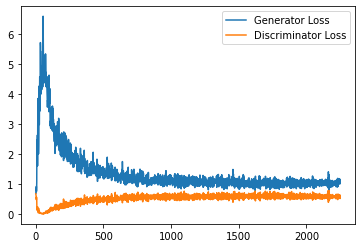

Step 45500: Generator loss: 1.0816997559070587, discriminator loss: 0.5791611569523811


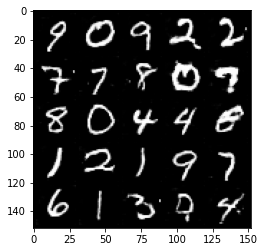

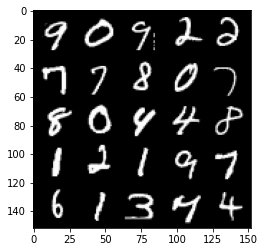

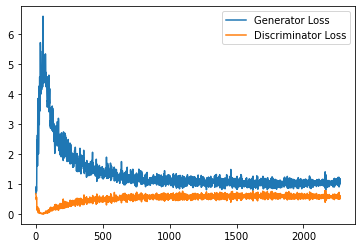

Step 46000: Generator loss: 1.0480991538763047, discriminator loss: 0.5748716731071473


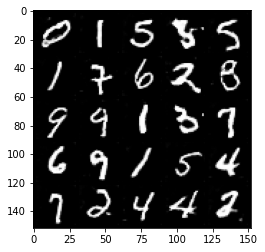

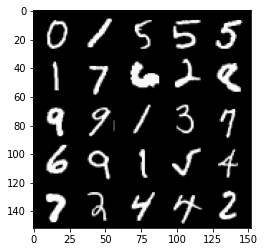

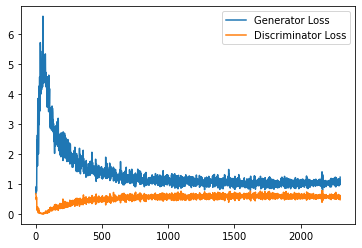

Step 46500: Generator loss: 1.059349789261818, discriminator loss: 0.5736826207637787


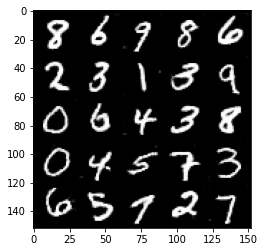

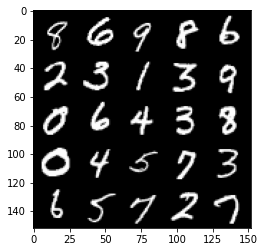

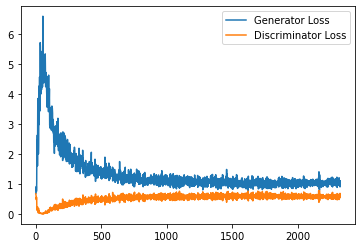

Step 47000: Generator loss: 1.07855455160141, discriminator loss: 0.566055334687233


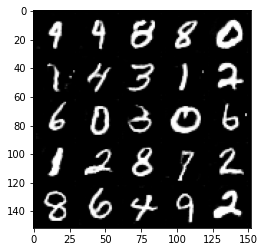

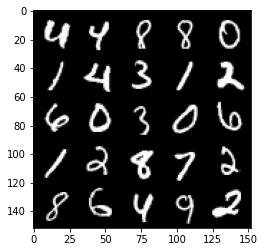

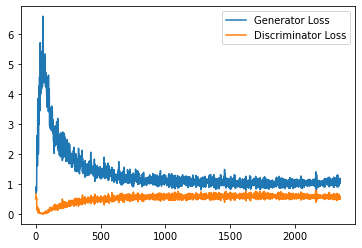

Step 47500: Generator loss: 1.0790578141212464, discriminator loss: 0.5729362797737122


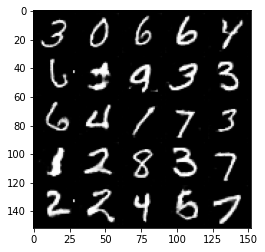

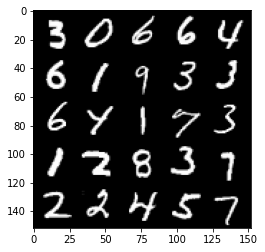

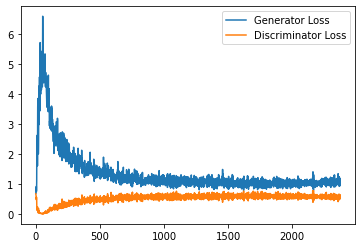

Step 48000: Generator loss: 1.056519050002098, discriminator loss: 0.5720939688086509


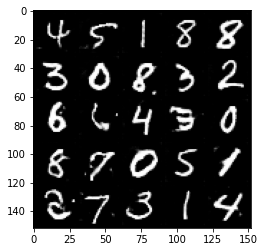

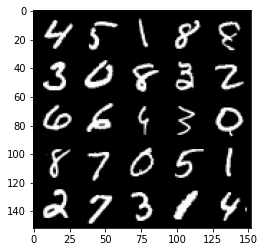

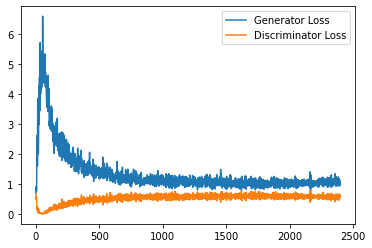

Step 48500: Generator loss: 1.072914282798767, discriminator loss: 0.5758598937392235


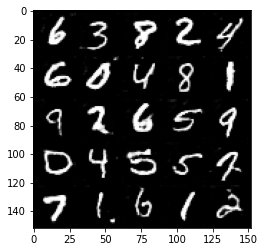

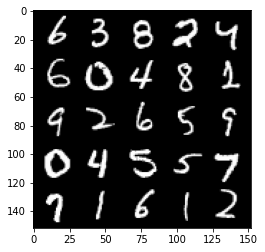

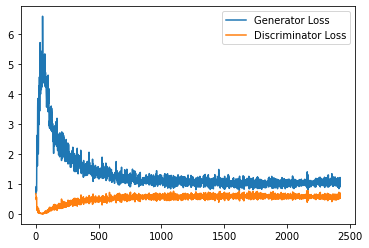

Step 49000: Generator loss: 1.040632003903389, discriminator loss: 0.562690233707428


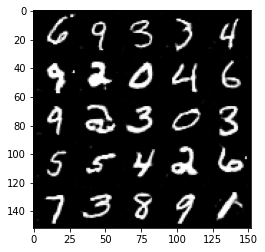

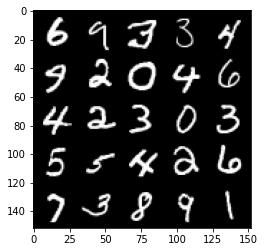

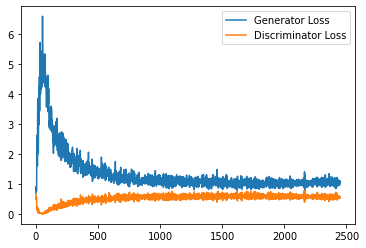

Step 49500: Generator loss: 1.0769230039119722, discriminator loss: 0.568706607401371


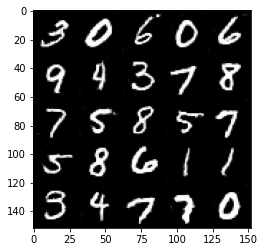

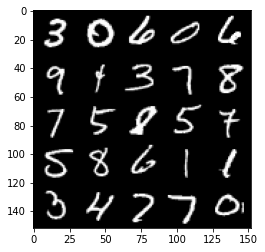

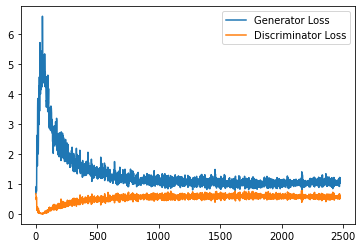

Step 50000: Generator loss: 1.0866824190616609, discriminator loss: 0.5655846499204635


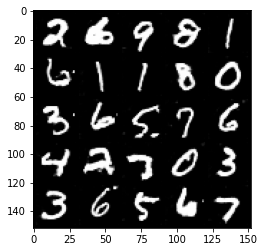

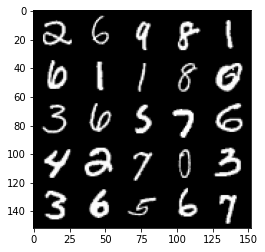

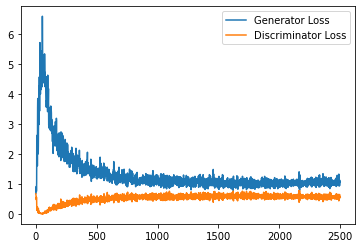

Step 50500: Generator loss: 1.0590807143449783, discriminator loss: 0.5663057765960693


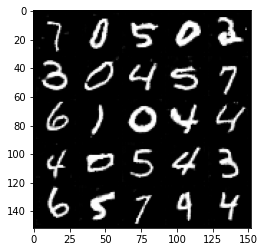

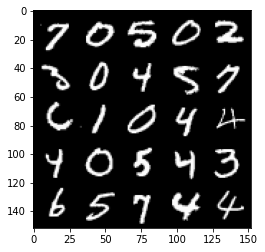

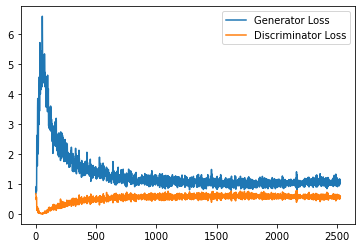

Step 51000: Generator loss: 1.0948254458904267, discriminator loss: 0.5644473738074303


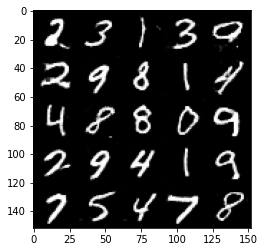

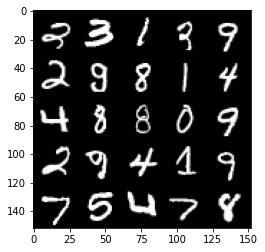

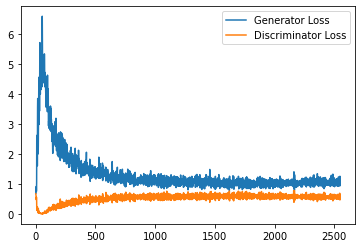

Step 51500: Generator loss: 1.0962679517269134, discriminator loss: 0.5629704096317292


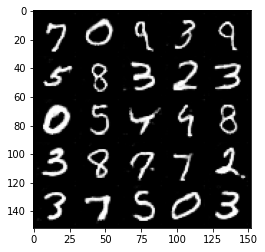

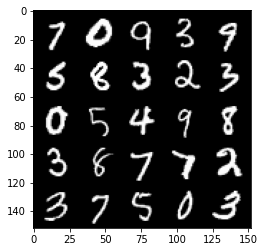

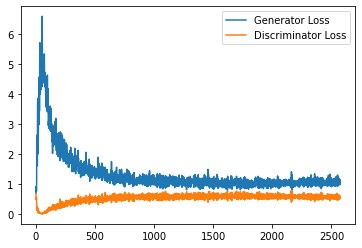

Step 52000: Generator loss: 1.0568362122774124, discriminator loss: 0.5617298447489738


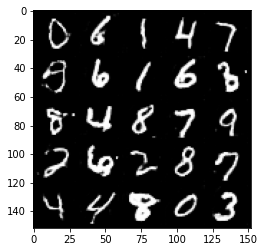

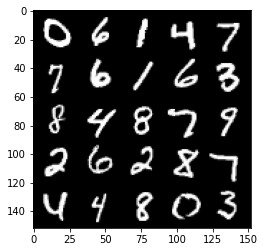

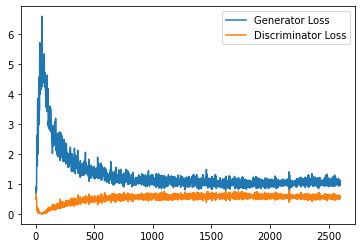

Step 52500: Generator loss: 1.0705589505434037, discriminator loss: 0.5653078241944313


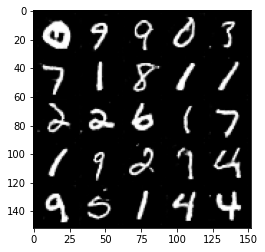

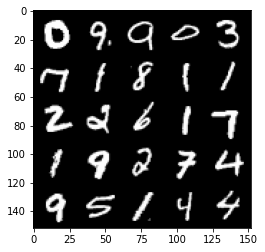

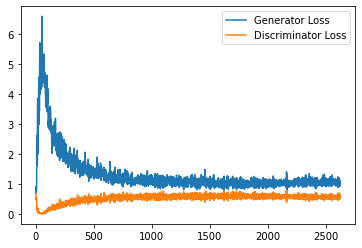

Step 53000: Generator loss: 1.0722553496360778, discriminator loss: 0.5603255270123482


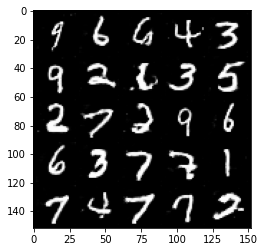

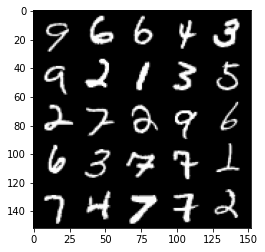

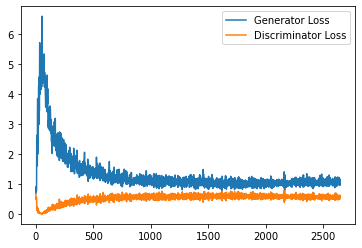

Step 53500: Generator loss: 1.0932631394863128, discriminator loss: 0.5644660713672638


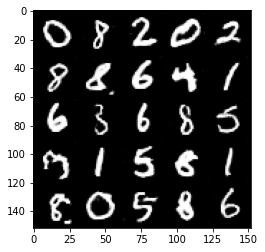

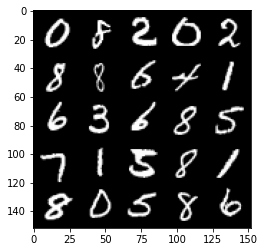

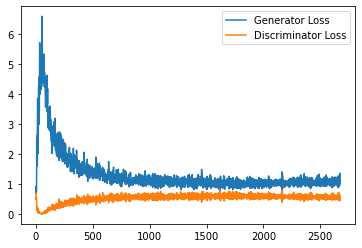

Step 54000: Generator loss: 1.0804594435691834, discriminator loss: 0.5645401251912117


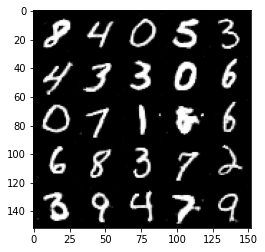

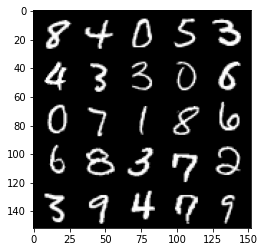

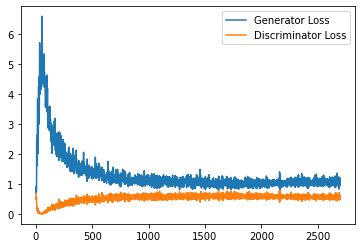

Step 54500: Generator loss: 1.1021559660434723, discriminator loss: 0.5515284367203712


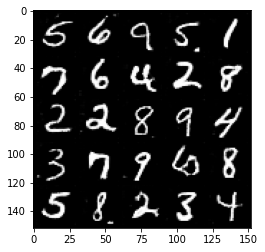

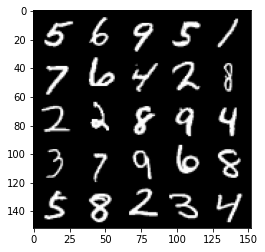

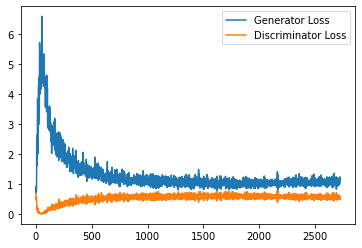

Step 55000: Generator loss: 1.1071850838661195, discriminator loss: 0.5607088436484337


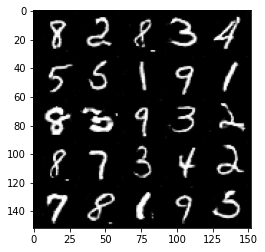

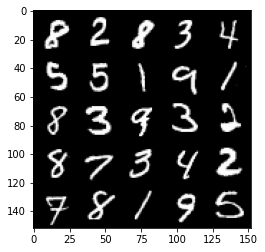

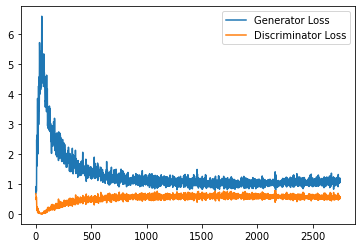

Step 55500: Generator loss: 1.1170363218784332, discriminator loss: 0.5592260054349899


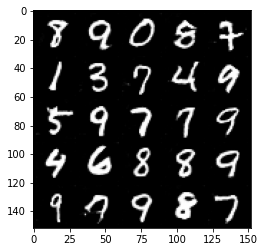

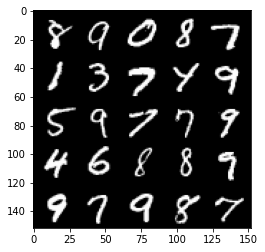

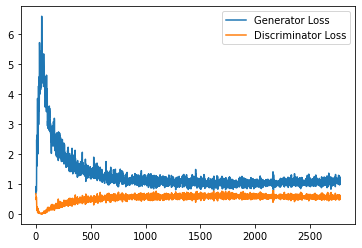

Step 56000: Generator loss: 1.1138191134929658, discriminator loss: 0.5598081941604615


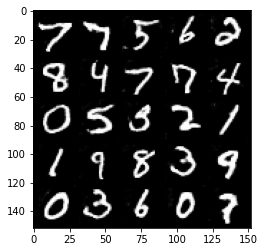

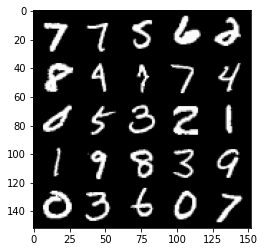

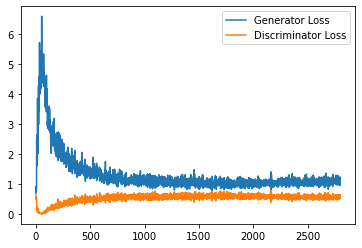

Step 56500: Generator loss: 1.1355117684602738, discriminator loss: 0.5534578460454941


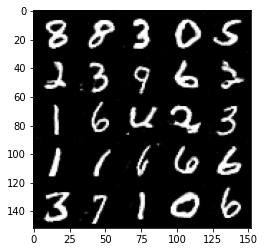

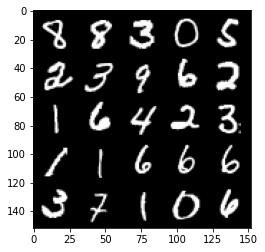

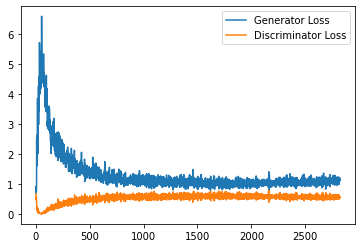

Step 57000: Generator loss: 1.1213660547733306, discriminator loss: 0.5607990491390228


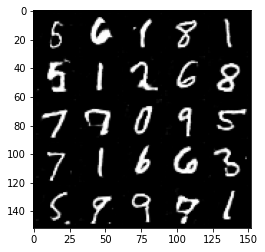

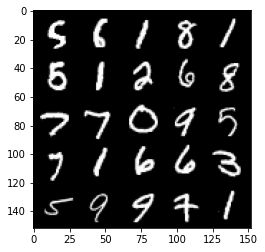

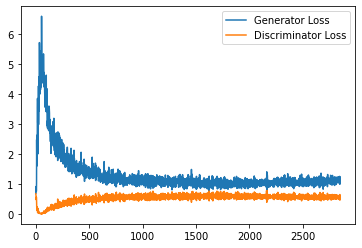

Step 57500: Generator loss: 1.0853947812318803, discriminator loss: 0.5602116495370865


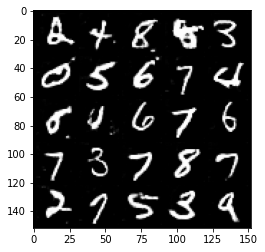

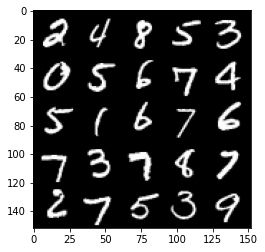

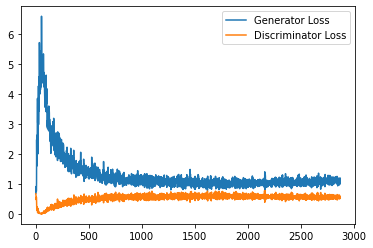

Step 58000: Generator loss: 1.0894247534275054, discriminator loss: 0.5531845140457153


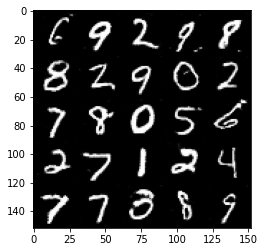

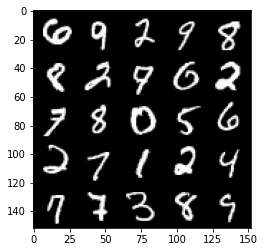

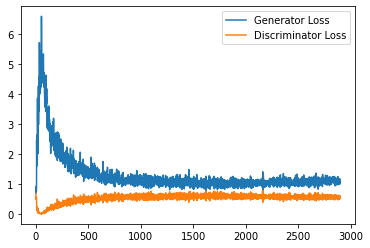

Step 58500: Generator loss: 1.1160699768066407, discriminator loss: 0.5534810289144516


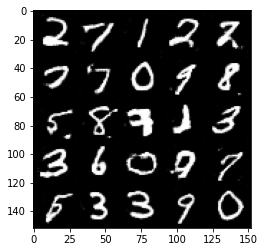

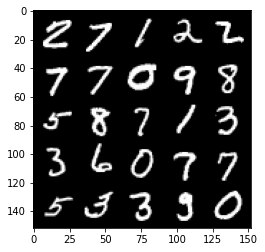

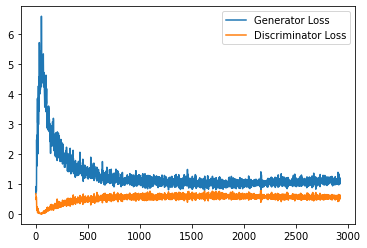

Step 59000: Generator loss: 1.100140549302101, discriminator loss: 0.5500878931879998


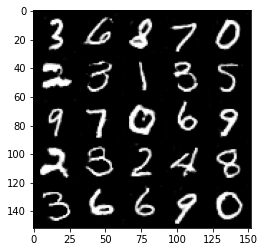

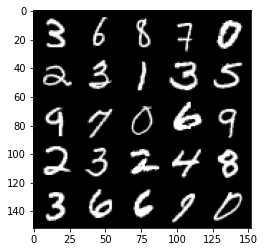

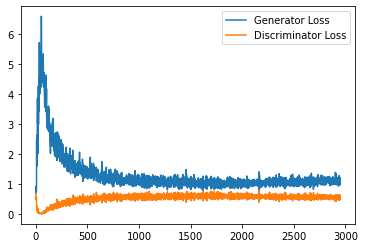

Step 59500: Generator loss: 1.1215477335453032, discriminator loss: 0.5491558326482773


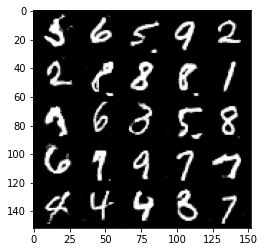

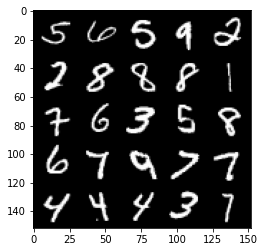

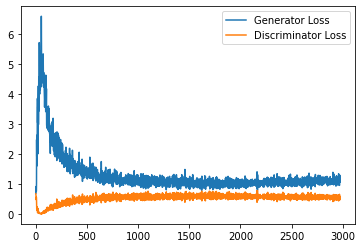

Step 60000: Generator loss: 1.1166446231603622, discriminator loss: 0.5588901093602181


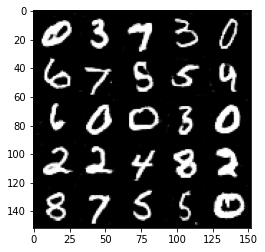

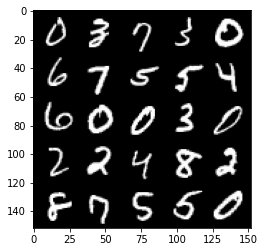

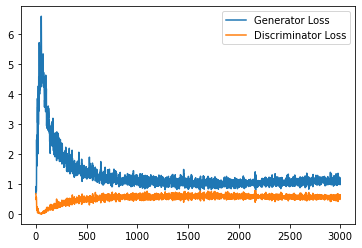

Step 60500: Generator loss: 1.0991116261482239, discriminator loss: 0.5558431589007378


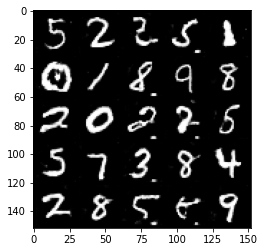

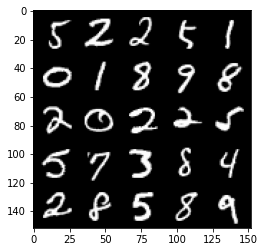

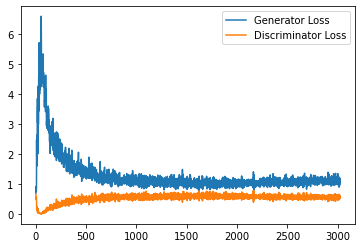

Step 61000: Generator loss: 1.117189735531807, discriminator loss: 0.5592889114022255


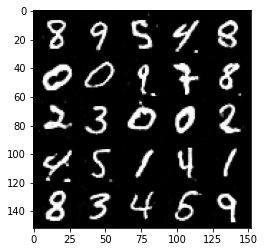

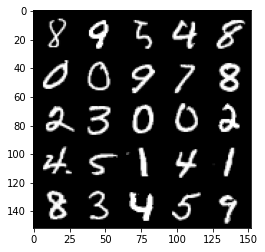

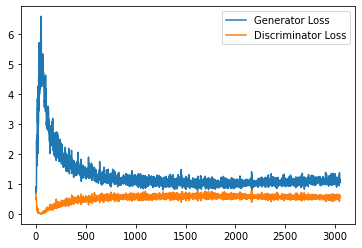

Step 61500: Generator loss: 1.12316103887558, discriminator loss: 0.5533121259212493


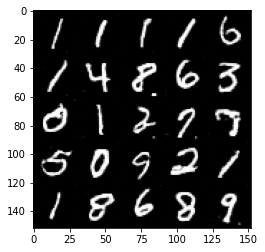

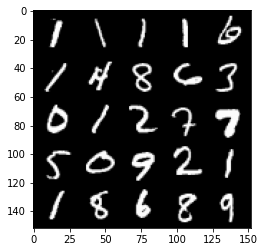

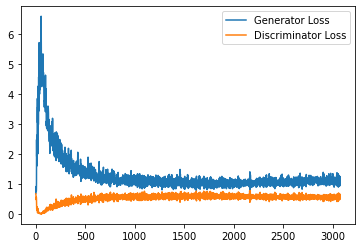

Step 62000: Generator loss: 1.125897222161293, discriminator loss: 0.5562391490936279


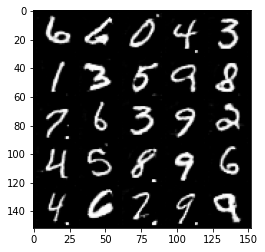

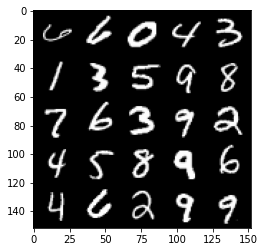

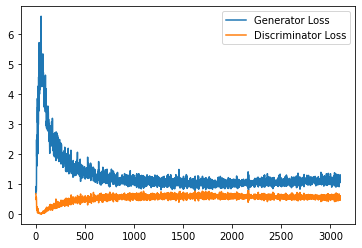

Step 62500: Generator loss: 1.1058596227169037, discriminator loss: 0.5572833052873611


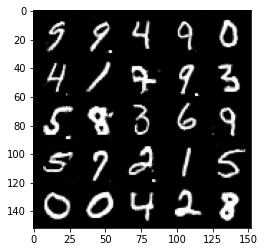

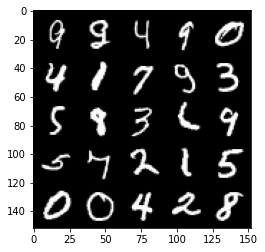

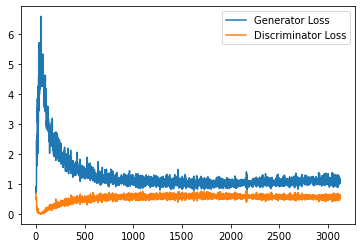

Step 63000: Generator loss: 1.113581933259964, discriminator loss: 0.5543484464883804


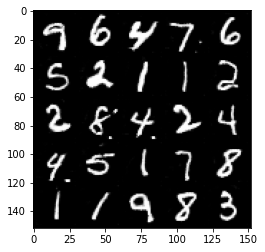

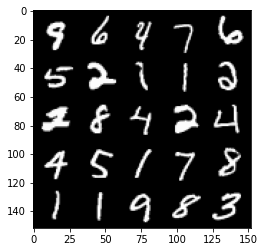

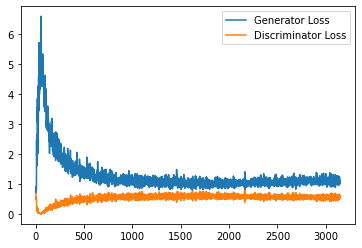

Step 63500: Generator loss: 1.1242962148189544, discriminator loss: 0.5577367156147957


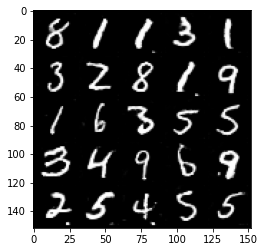

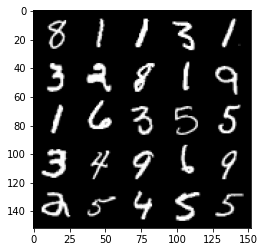

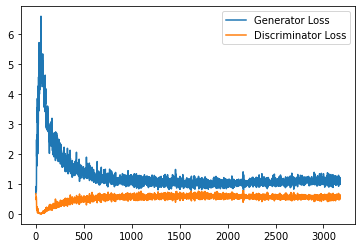

Step 64000: Generator loss: 1.1139476724863053, discriminator loss: 0.5545490128397942


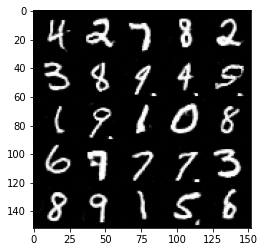

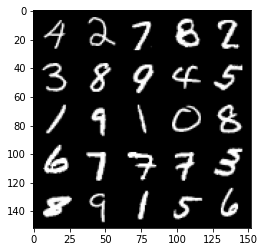

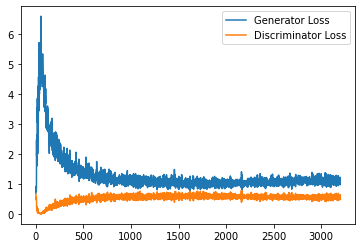

Step 64500: Generator loss: 1.1143964015245438, discriminator loss: 0.5473837358951569


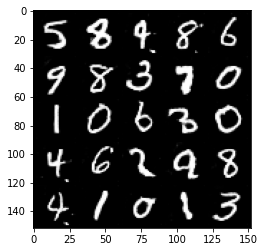

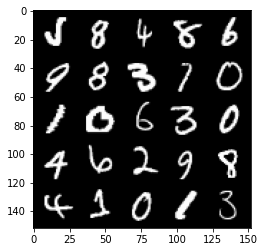

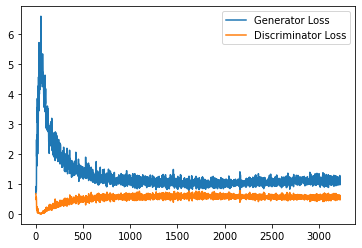

Step 65000: Generator loss: 1.12965680873394, discriminator loss: 0.5562456931471824


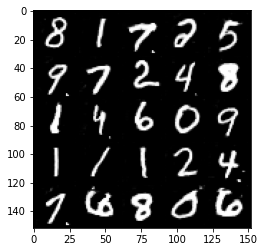

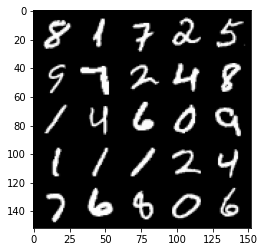

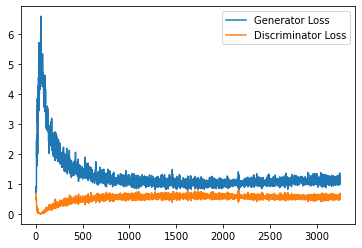

Step 65500: Generator loss: 1.1330703165531157, discriminator loss: 0.5537888489961624


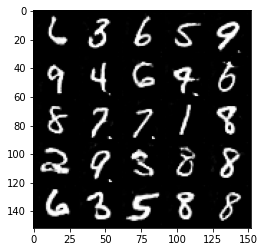

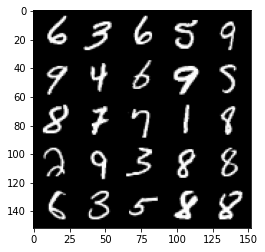

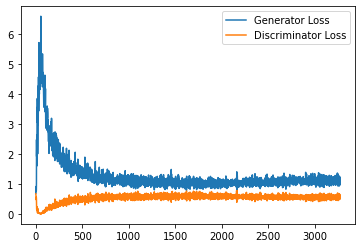

Step 66000: Generator loss: 1.117962695479393, discriminator loss: 0.5523803671598434


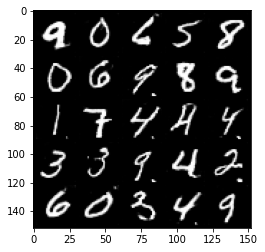

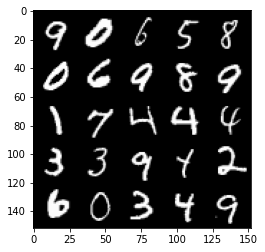

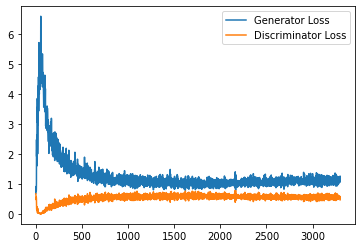

Step 66500: Generator loss: 1.108790960907936, discriminator loss: 0.5573307871222496


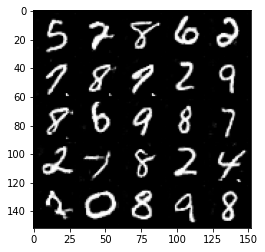

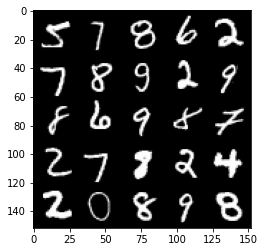

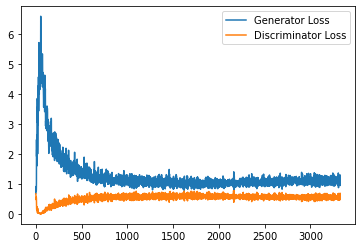

Step 67000: Generator loss: 1.1290562410354614, discriminator loss: 0.5584950085282325


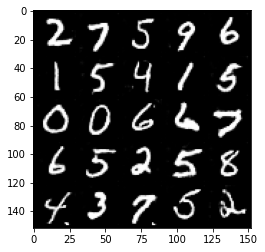

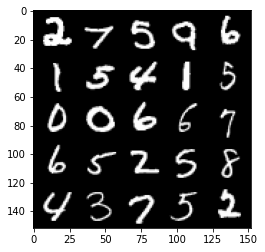

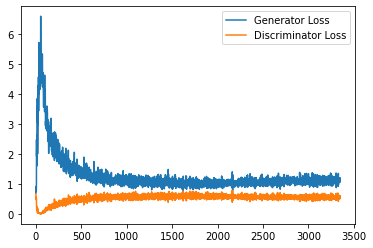

Step 67500: Generator loss: 1.121514469385147, discriminator loss: 0.5512917886376381


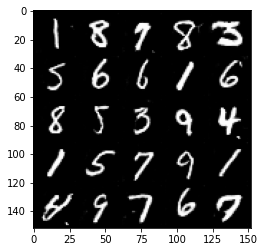

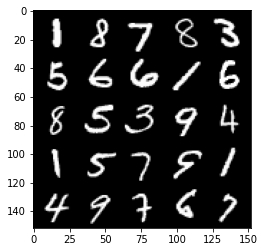

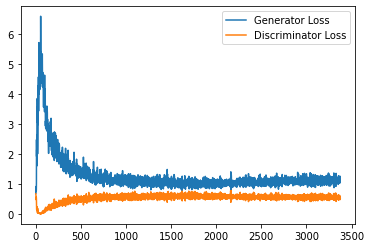

Step 68000: Generator loss: 1.154722250699997, discriminator loss: 0.5556824098229408


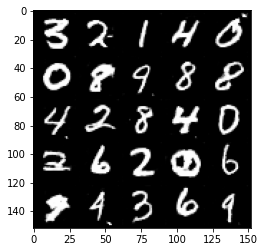

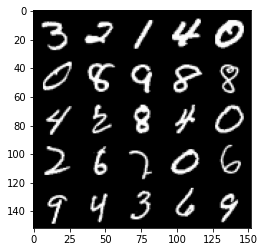

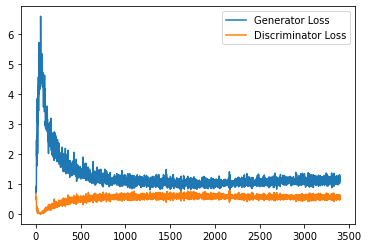

Step 68500: Generator loss: 1.1320460963249206, discriminator loss: 0.5501997556686401


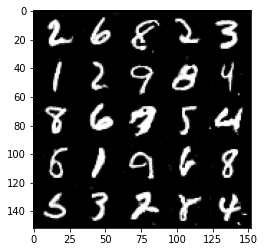

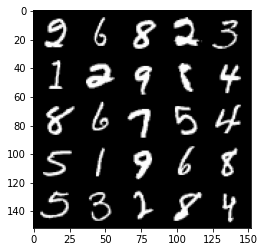

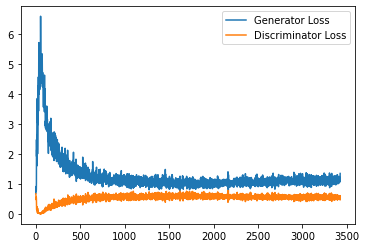

Step 69000: Generator loss: 1.1380617781877518, discriminator loss: 0.5509341990947724


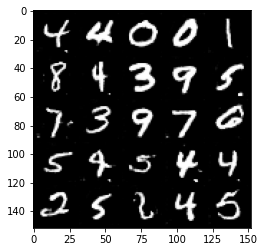

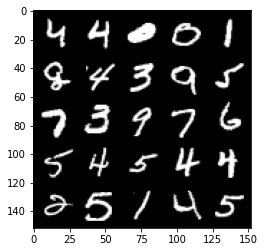

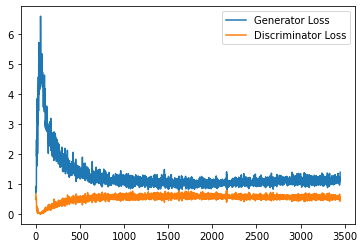

Step 69500: Generator loss: 1.115335143327713, discriminator loss: 0.5653866147398948


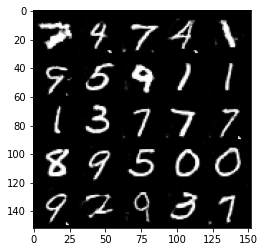

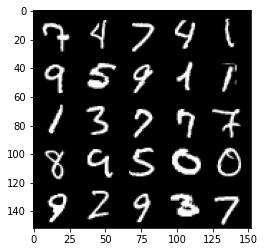

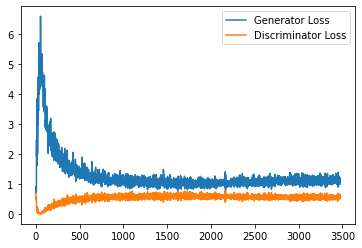

Step 70000: Generator loss: 1.1215885858535766, discriminator loss: 0.5545299679636956


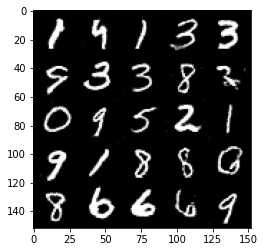

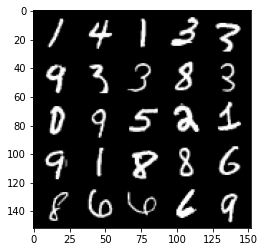

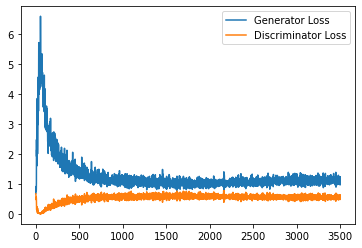

Step 70500: Generator loss: 1.1300851826667786, discriminator loss: 0.5490494373440743


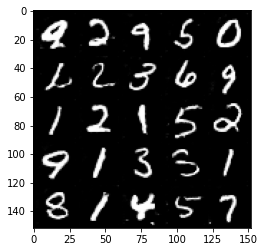

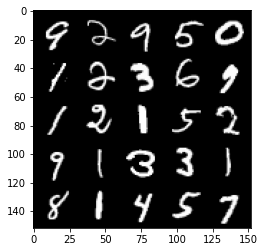

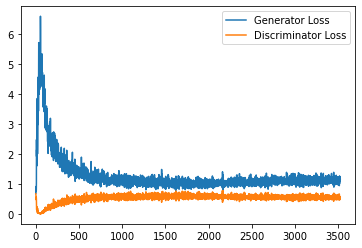

Step 71000: Generator loss: 1.1093722447156906, discriminator loss: 0.5592362866401672


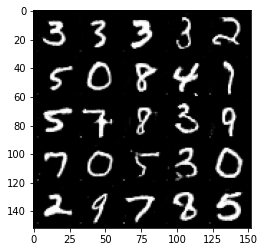

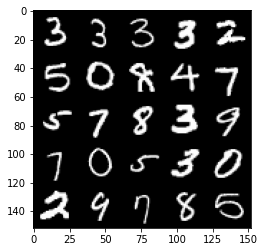

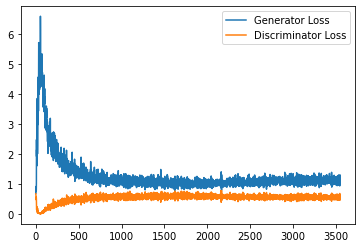

Step 71500: Generator loss: 1.1231472866535186, discriminator loss: 0.5616426859498024


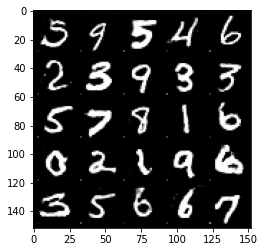

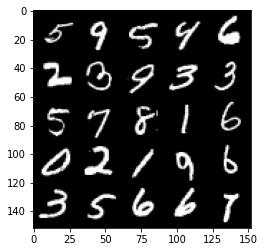

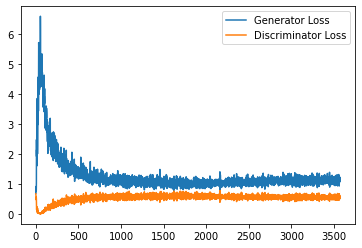

Step 72000: Generator loss: 1.170812068581581, discriminator loss: 0.5642263134717941


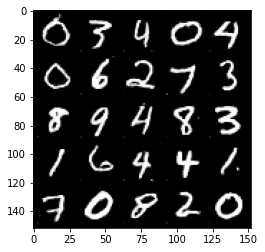

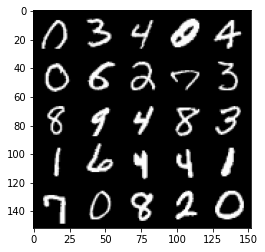

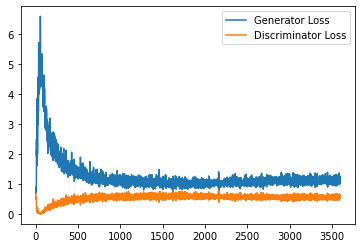

Step 72500: Generator loss: 1.1188504556417465, discriminator loss: 0.5607275609374046


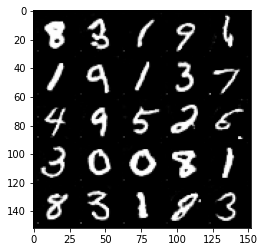

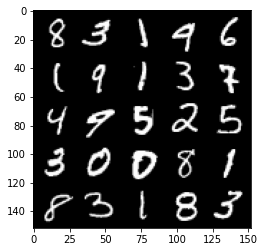

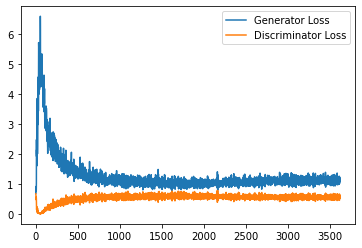

Step 73000: Generator loss: 1.1098270695209502, discriminator loss: 0.5590883576273918


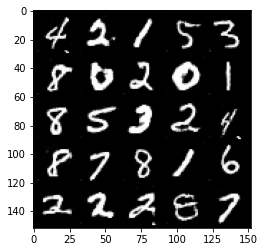

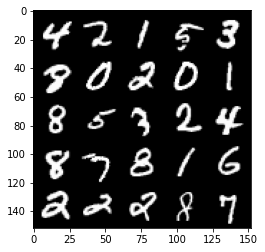

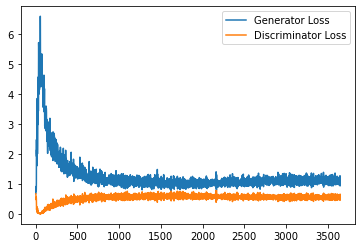

Step 73500: Generator loss: 1.1279958443641662, discriminator loss: 0.552621726512909


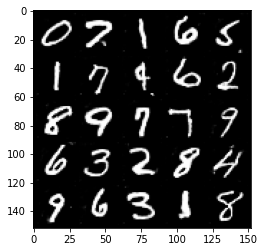

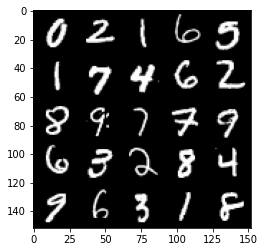

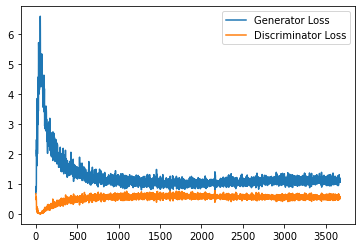

Step 74000: Generator loss: 1.1026058073043823, discriminator loss: 0.5583917759656906


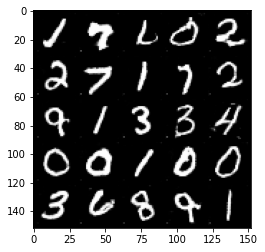

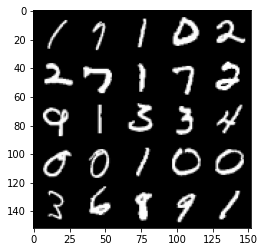

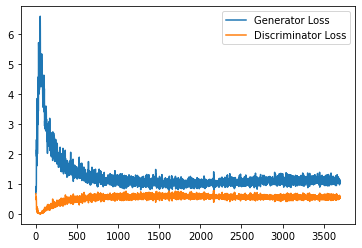

Step 74500: Generator loss: 1.1189163826704025, discriminator loss: 0.5587346949577332


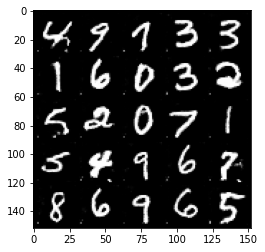

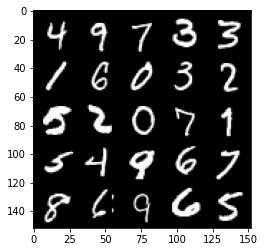

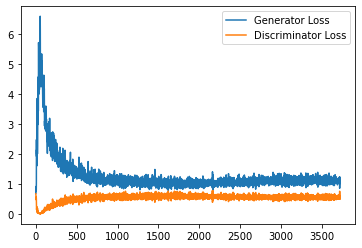

Step 75000: Generator loss: 1.1380279630422592, discriminator loss: 0.5691864547729493


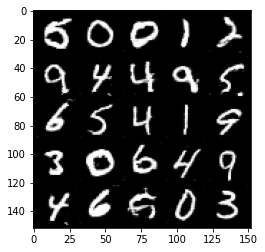

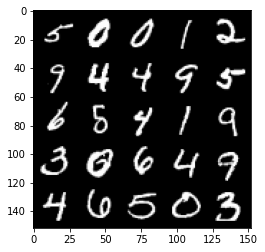

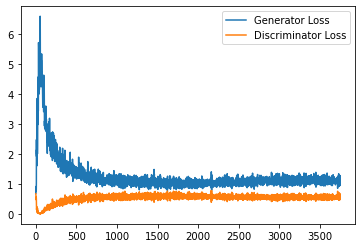

Step 75500: Generator loss: 1.1401573762893678, discriminator loss: 0.5624557063579559


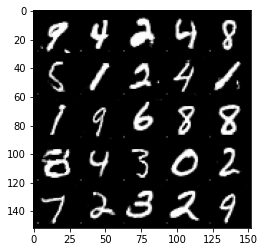

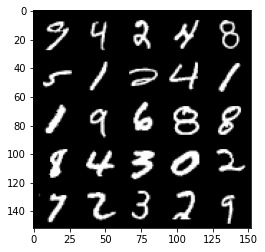

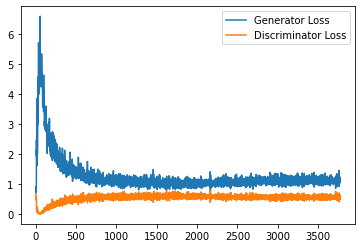

Step 76000: Generator loss: 1.1538356536626815, discriminator loss: 0.5552467639446259


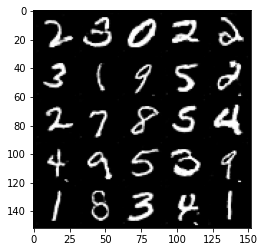

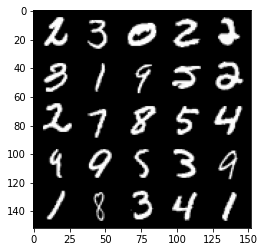

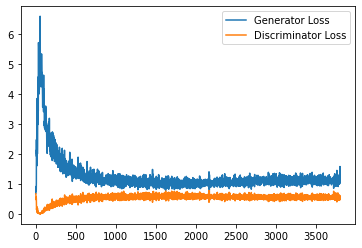

Step 76500: Generator loss: 1.1195507383346557, discriminator loss: 0.5573499383330345


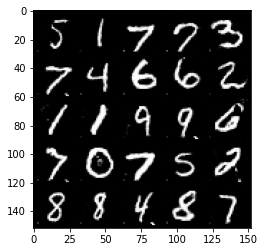

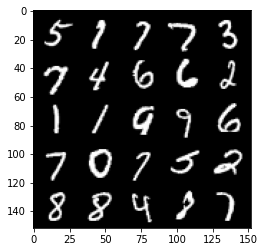

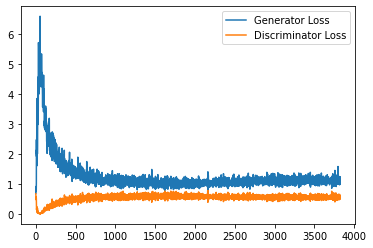

Step 77000: Generator loss: 1.1513190751075744, discriminator loss: 0.557638625562191


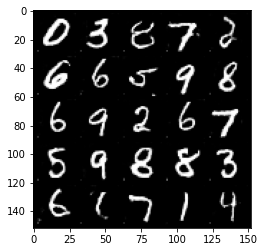

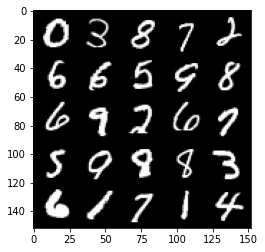

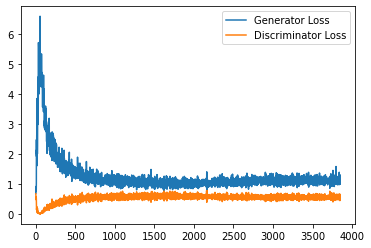

Step 77500: Generator loss: 1.114314317703247, discriminator loss: 0.5632706507444382


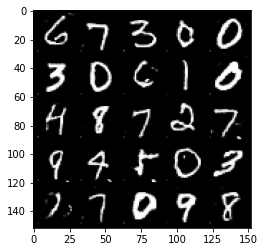

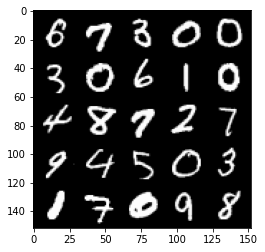

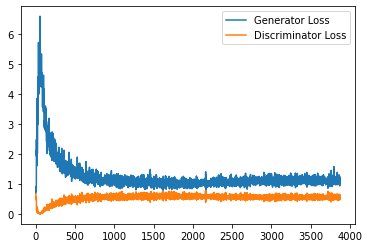

Step 78000: Generator loss: 1.1225396795272826, discriminator loss: 0.5560334973931312


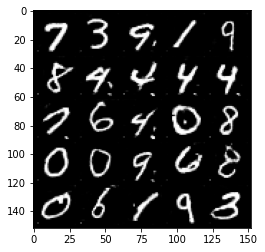

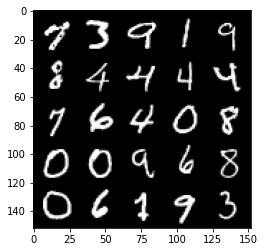

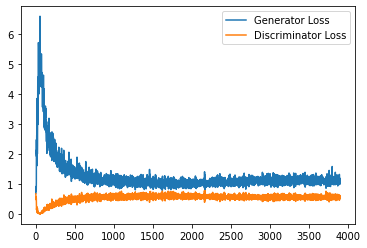

Step 78500: Generator loss: 1.105390315771103, discriminator loss: 0.5627738785147667


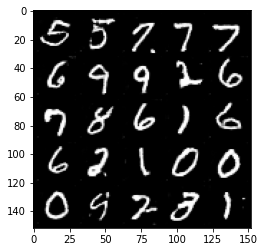

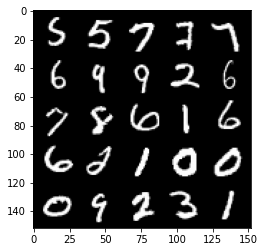

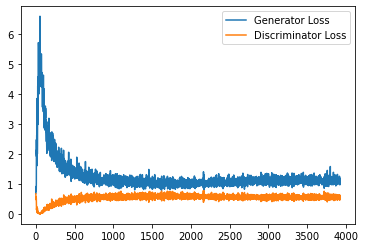

Step 79000: Generator loss: 1.1399796493053436, discriminator loss: 0.5577611741423607


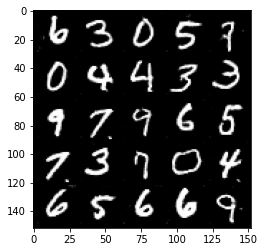

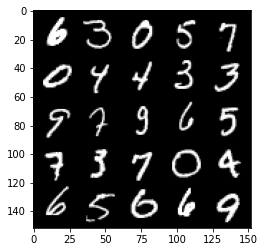

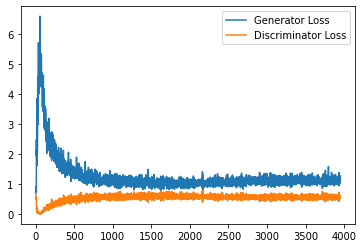

Step 79500: Generator loss: 1.1342260875701904, discriminator loss: 0.5556737347841263


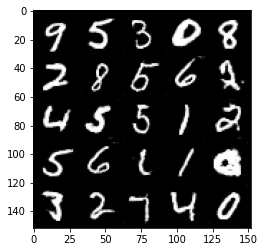

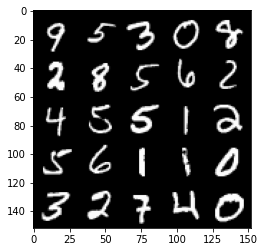

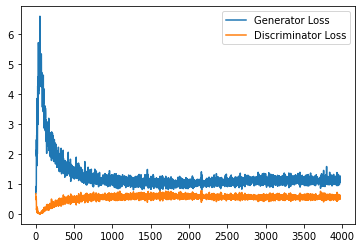

Step 80000: Generator loss: 1.134806075811386, discriminator loss: 0.5600433568954468


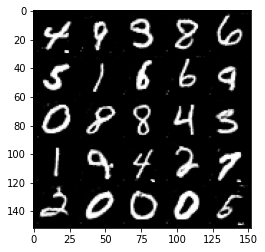

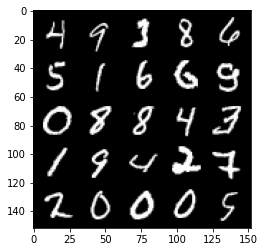

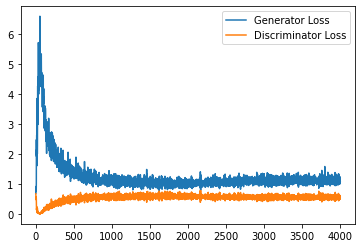

Step 80500: Generator loss: 1.1302992805242538, discriminator loss: 0.560985266983509


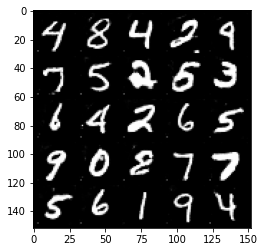

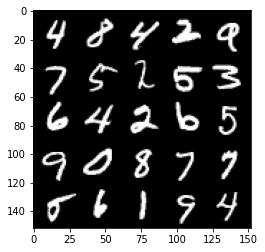

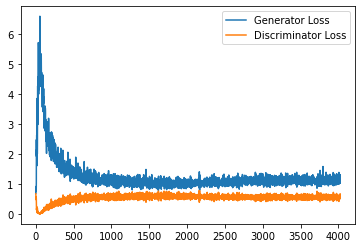

Step 81000: Generator loss: 1.1487591890096664, discriminator loss: 0.5624561797976494


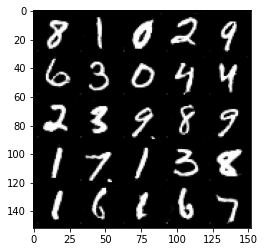

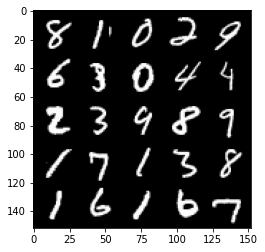

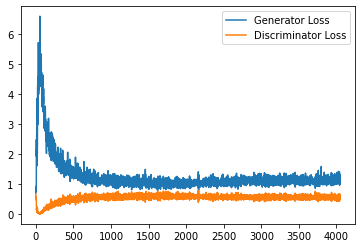

Step 81500: Generator loss: 1.102120434999466, discriminator loss: 0.5543113250136376


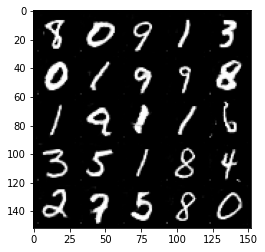

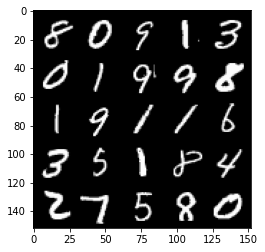

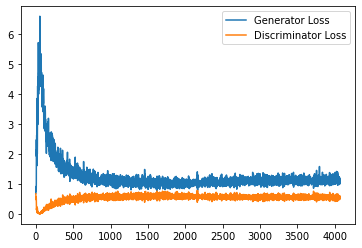

Step 82000: Generator loss: 1.1261344938278197, discriminator loss: 0.5595672589540481


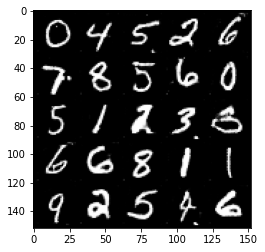

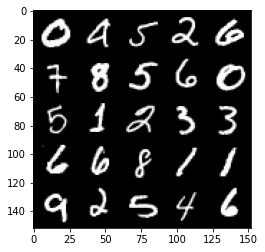

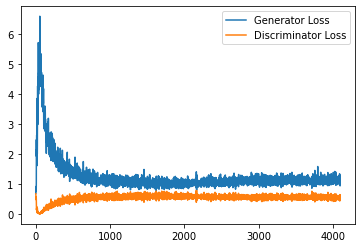

Step 82500: Generator loss: 1.1287755652666092, discriminator loss: 0.553458634853363


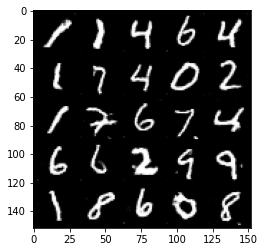

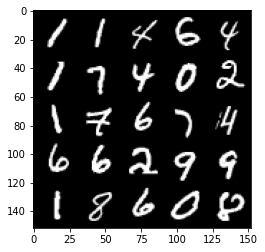

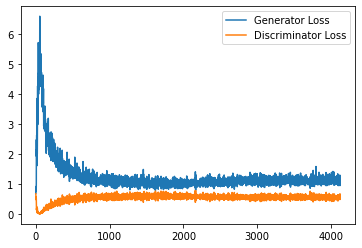

Step 83000: Generator loss: 1.1286921159029006, discriminator loss: 0.5567570921778678


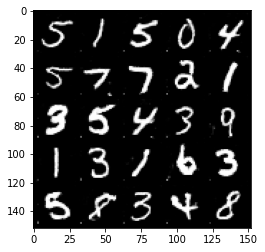

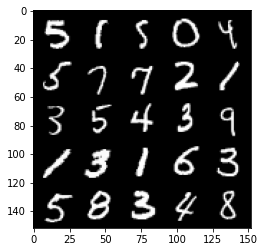

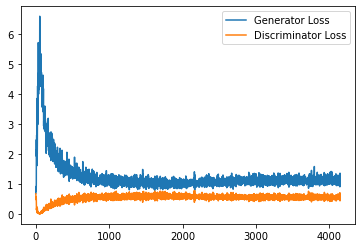

Step 83500: Generator loss: 1.12796508705616, discriminator loss: 0.5508253323435783


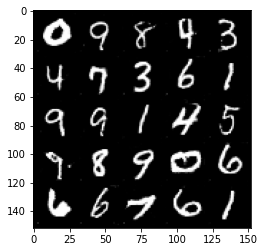

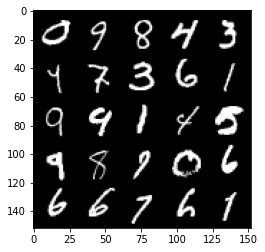

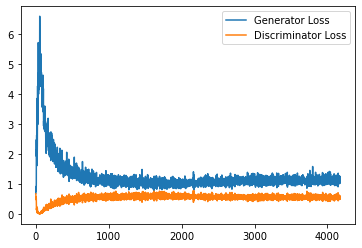

Step 84000: Generator loss: 1.167687467098236, discriminator loss: 0.5538100867271424


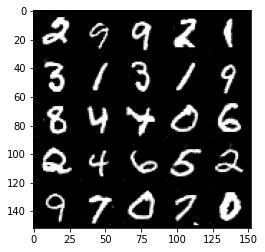

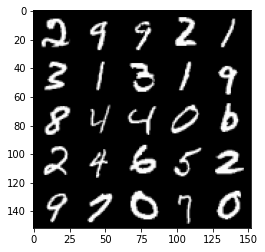

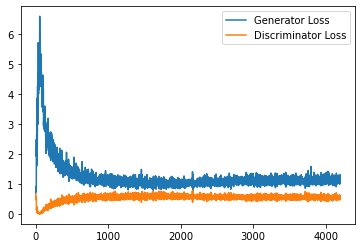

Step 84500: Generator loss: 1.1355543925762177, discriminator loss: 0.5599539915919304


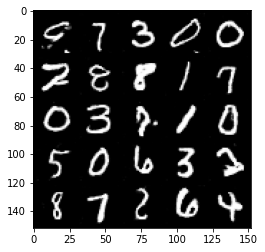

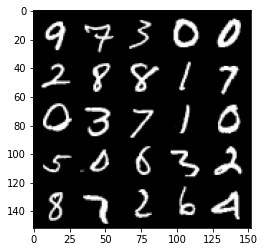

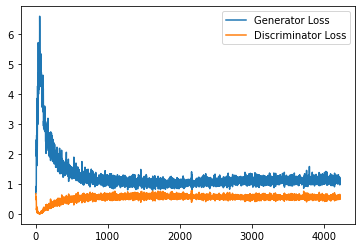

Step 85000: Generator loss: 1.1247785904407501, discriminator loss: 0.5530435162782669


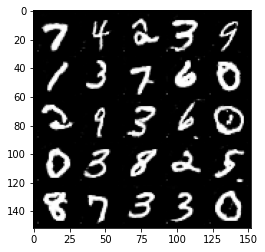

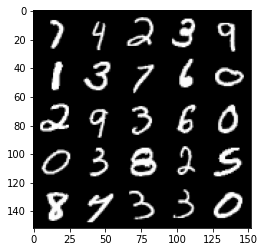

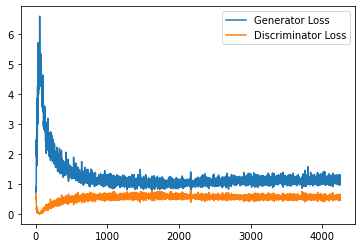

Step 85500: Generator loss: 1.1509885985851287, discriminator loss: 0.5493554392457008


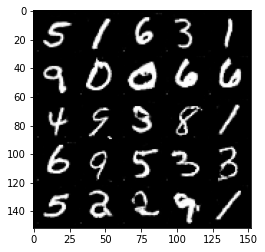

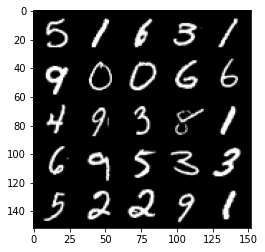

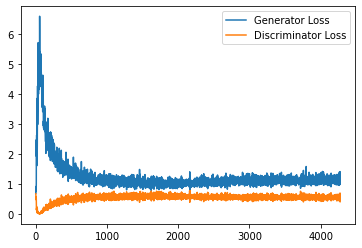

Step 86000: Generator loss: 1.1376550742387772, discriminator loss: 0.5595767760872841


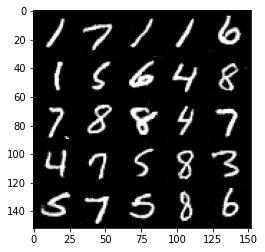

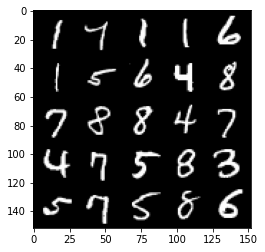

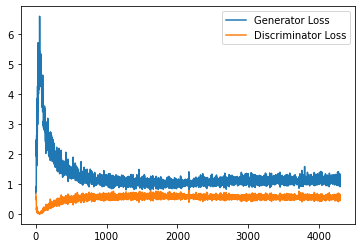

Step 86500: Generator loss: 1.1268733766078949, discriminator loss: 0.5546665219664574


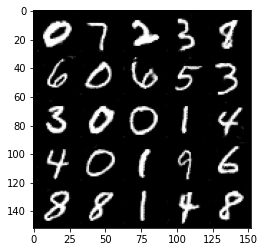

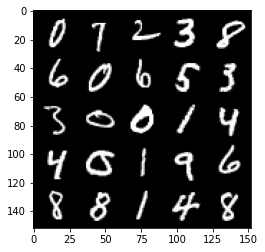

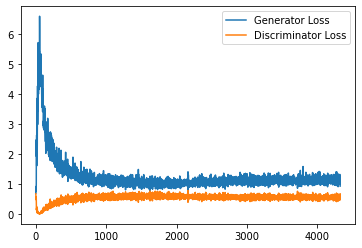

Step 87000: Generator loss: 1.1284260092973708, discriminator loss: 0.5514006854295731


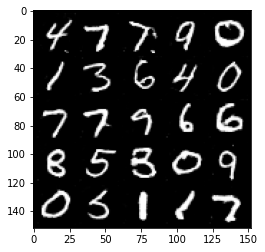

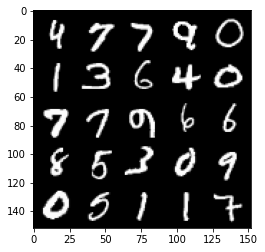

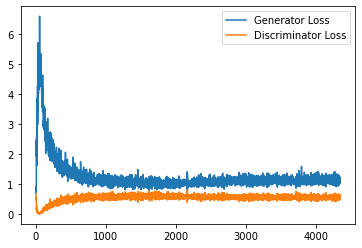

Step 87500: Generator loss: 1.1448323429822922, discriminator loss: 0.5582947928905487


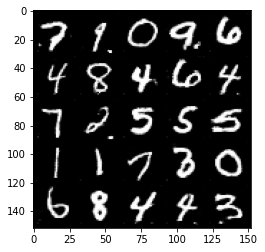

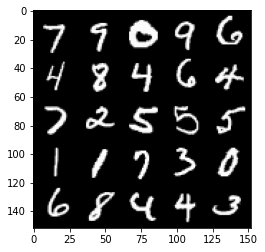

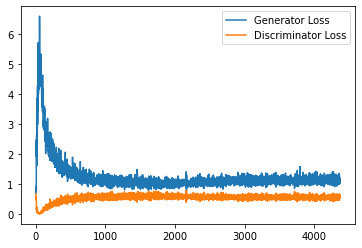

Step 88000: Generator loss: 1.1415226086378099, discriminator loss: 0.5532108365297318


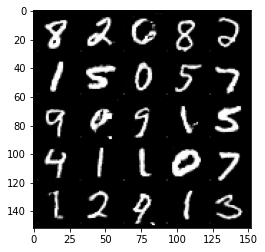

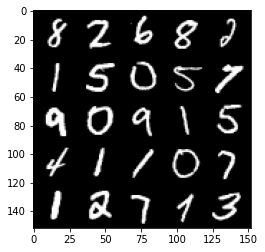

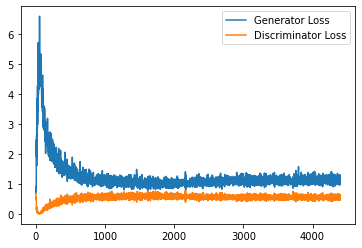

Step 88500: Generator loss: 1.1444715640544891, discriminator loss: 0.5592180171012878


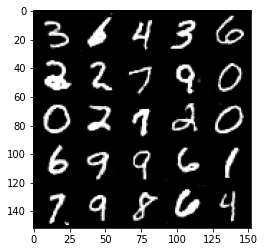

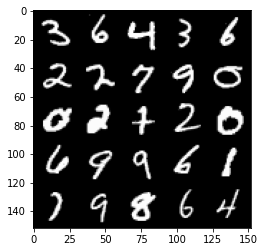

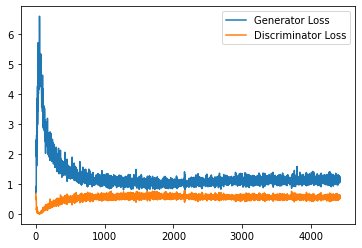

Step 89000: Generator loss: 1.1407667706012725, discriminator loss: 0.5591815797686577


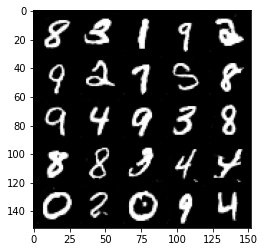

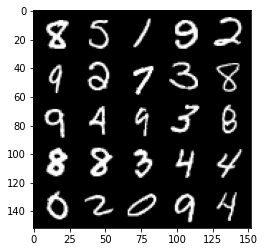

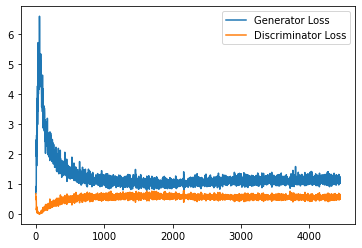

Step 89500: Generator loss: 1.111536915898323, discriminator loss: 0.555641594171524


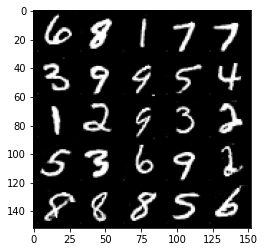

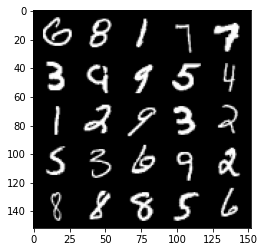

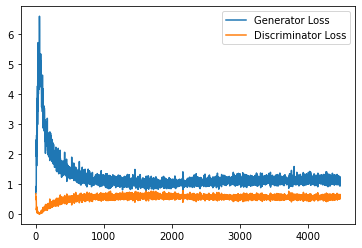

Step 90000: Generator loss: 1.1361307117938995, discriminator loss: 0.5526000725626945


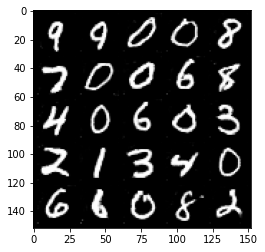

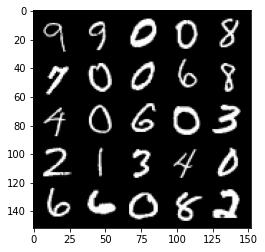

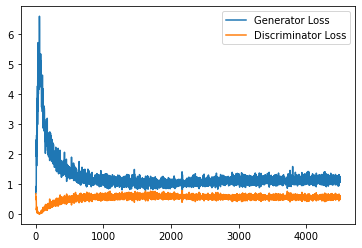

Step 90500: Generator loss: 1.1289085030555726, discriminator loss: 0.5556950753927231


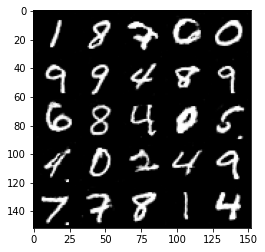

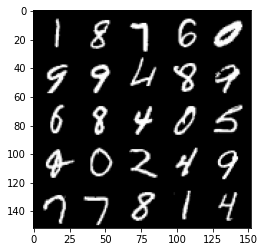

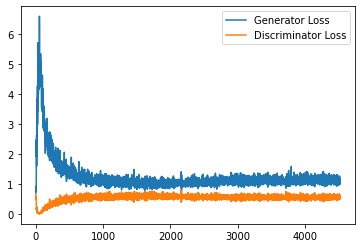

Step 91000: Generator loss: 1.1309137041568755, discriminator loss: 0.5558595361709595


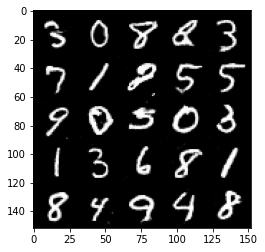

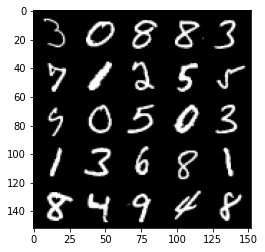

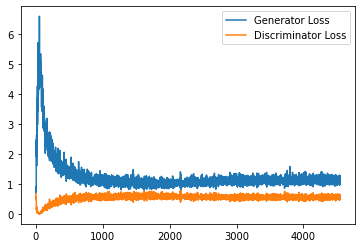

Step 91500: Generator loss: 1.1631170667409896, discriminator loss: 0.5502725681662559


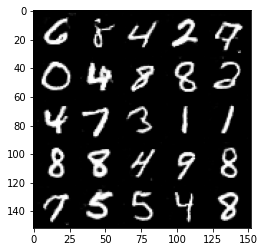

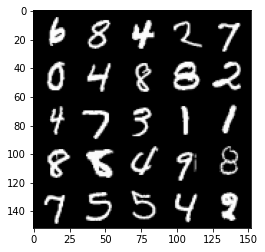

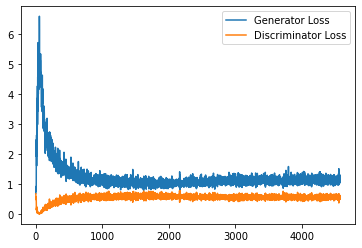

Step 92000: Generator loss: 1.156664128422737, discriminator loss: 0.5522343183755875


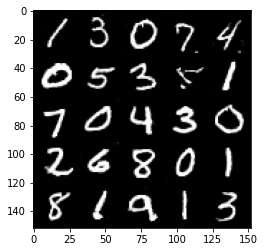

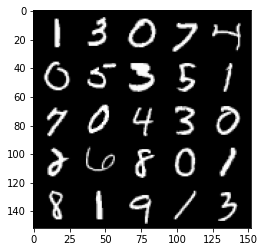

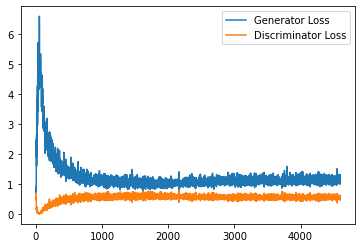

Step 92500: Generator loss: 1.1452112505435943, discriminator loss: 0.5508176549673081


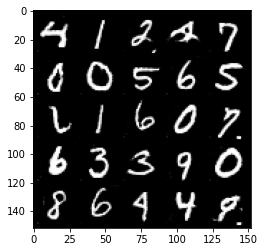

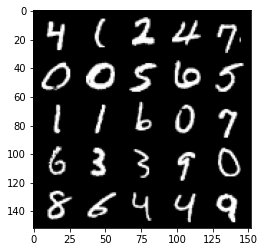

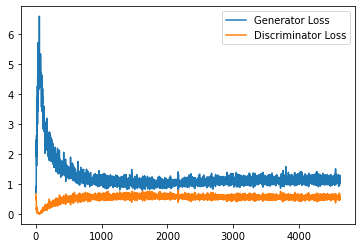

Step 93000: Generator loss: 1.1372293604612351, discriminator loss: 0.5542990983724594


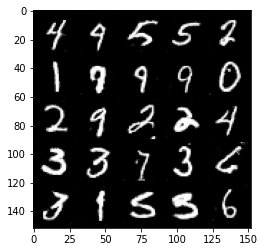

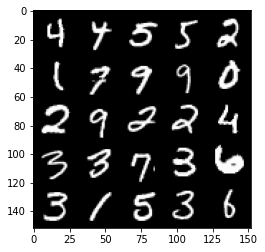

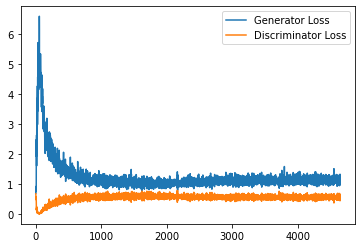

Step 93500: Generator loss: 1.1213284114599227, discriminator loss: 0.5597018121480942


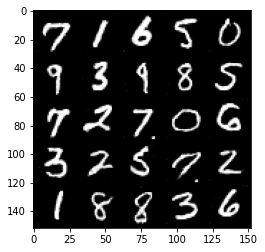

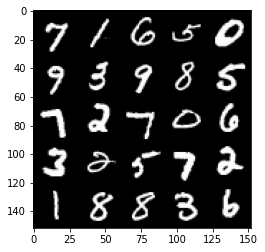

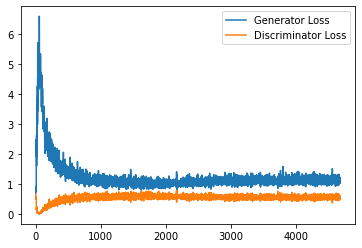

In [23]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED CELL
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        #### START CODE HERE ####
        noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
        fake = gen(noise_and_labels)
        #### END CODE HERE ####
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        #### START CODE HERE ####
        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels)
        disc_real_pred = disc(real_image_and_labels)
        #### END CODE HERE ####
        
        # Make sure shapes are correct 
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Shapes must match
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)
        
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [ ]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

In [ ]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 1 # Choose the start digit
### Change me! ###
end_plot_number = 5 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Uncomment the following lines of code if you would like to visualize a set of pairwise class 
### interpolations for a collection of different numbers, all in a single grid of interpolations.
### You'll also see another visualization like this in the next code block!
# plot_numbers = [2, 3, 4, 5, 7]
# n_numbers = len(plot_numbers)
# plt.figure(figsize=(8, 8))
# for i, first_plot_number in enumerate(plot_numbers):
#     for j, second_plot_number in enumerate(plot_numbers):
#         plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
#         interpolate_class(first_plot_number, second_plot_number)
#         plt.axis('off')
# plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
# plt.show()
# plt.close()

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

In [ ]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 5 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()